In [1]:
import os
import glob as glob
import matplotlib.pyplot as plt
import cv2
import requests

## Hyperparameters and Constants

Here, we define wether to train the model or not and for how many epochs to train for.

If `TRAIN = False`, then the last trained model will be used for inference in the notebook if run end to end.

In [2]:
TRAIN = True
# Number of epochs to train for.
EPOCHS = 25

## Download and Prepare the Dataset

We will use the <a href="https://www.kaggle.com/datasets/saumyapatel/traffic-vehicles-object-detection" target="_blank">Traffic vehicles Object Detection</a> dataset for training the custom YOLOv5 object detector.

The following function is for downloading any file in the notebook. We can also use it for downloading the dataset and later on for downloading the inference data as well.

In [3]:
def download_file(url, save_name):
    url = url
    if not os.path.exists(save_name):
        file = requests.get(url)
        open(save_name, 'wb').write(file.content)
    else: 
        print('File already present, skipping download...')

In [4]:
download_file(
    'https://learnopencv.s3.us-west-2.amazonaws.com/traffic-vehicles-object-detection.zip',
    'traffic-vehicles-object-detection.zip'
)
if not os.path.exists('Traffic Dataset'):
    !unzip -q "traffic-vehicles-object-detection.zip"
else:
    print('Dataset already present')

File already present, skipping download...
Dataset already present


### Create Dataset YAML File

First, we need to create the dataset YAML (`data.yaml`) file containing the path to the training and validation images and labels. This file will also contain the class names from the dataset.

The dataset contains 7 classes: **Car, Number Plate, Blur Number Plate, Two Wheeler, Auto, Bus, and Truck**.

In [5]:
%%writefile data.yaml
path: "../Traffic Dataset" # Path relative to the `train.py` script. 
train: images/train 
val: images/val 

# Classes
nc: 7
names: [
    "Car", "Number Plate", "Blur Number Plate", "Two Wheeler", "Auto", "Bus", "Truck"
] 

Overwriting data.yaml


### Visualize a Few Ground Truth Images

Before moving forward, let's check out few of the ground truth images. 

The current annotations in the text files are in normalized `[x_center, y_center, width, height]` format. Let's write a function that will convert it back to `[x_min, y_min, x_max, y_max]` format.

In [6]:
class_names = [
    "Car", "Number Plate", "Blur Number Plate", 
    "Two Wheeler", "Auto", "Bus", "Truck"
] 

In [7]:
# Function to convert bounding boxes in YOLO format to xmin, ymin, xmax, ymax.
def yolo2bbox(bboxes):
    xmin, ymin = bboxes[0]-bboxes[2]/2, bboxes[1]-bboxes[3]/2
    xmax, ymax = bboxes[0]+bboxes[2]/2, bboxes[1]+bboxes[3]/2
    return xmin, ymin, xmax, ymax

In [8]:
def plot_box(image, bboxes, labels):
    # Need the image height and width to denormalize
    # the bounding box coordinates
    h, w, _ = image.shape
    for box_num, box in enumerate(bboxes):
        x1, y1, x2, y2 = yolo2bbox(box)
        # denormalize the coordinates
        xmin = int(x1*w)
        ymin = int(y1*h)
        xmax = int(x2*w)
        ymax = int(y2*h)
        width = xmax - xmin
        height = ymax - ymin
        cv2.rectangle(
            image, 
            (xmin, ymin), (xmax, ymax),
            color=(0, 0, 255),
            thickness=6
        ) 
        cv2.putText(
            image, 
            class_names[int(labels[box_num])],
            (xmin+1, ymin-10),
            cv2.FONT_HERSHEY_SIMPLEX,
            3,
            (0, 255, 0),
            10
        )
    return image

In [9]:
# Function to plot images with the bounding boxes.
def plot(image_paths, label_paths, num_samples):
    all_training_images = glob.glob(image_paths)
    all_training_labels = glob.glob(label_paths)
    all_training_images.sort()
    all_training_labels.sort()
    
    plt.figure(figsize=(21, 12))
    for i in range(num_samples):
        image = cv2.imread(all_training_images[i+10])
        with open(all_training_labels[i+10], 'r') as f:
            bboxes = []
            labels = []
            label_lines = f.readlines()
            for label_line in label_lines:
                label = label_line[0]
                bbox_string = label_line[2:]
                x_c, y_c, w, h = bbox_string.split(' ')
                x_c = float(x_c)
                y_c = float(y_c)
                w = float(w)
                h = float(h)
                bboxes.append([x_c, y_c, w, h])
                labels.append(label)
        result_image = plot_box(image, bboxes, labels)
        plt.subplot(2, 2, i+1)
        plt.imshow(result_image[:, :, ::-1])
        plt.axis('off')
    plt.show()

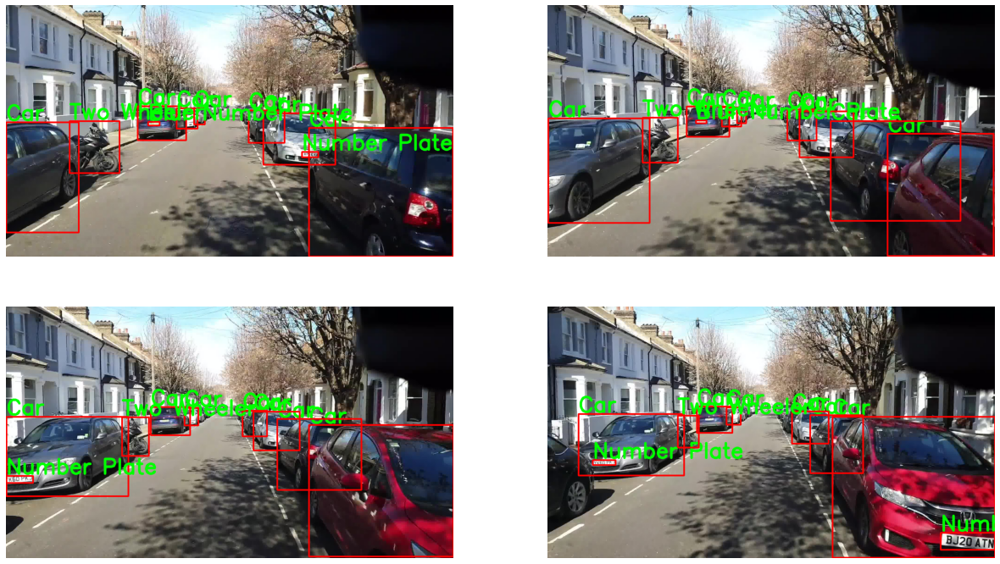

In [10]:
# Visualize a few training images.
plot(
    image_paths='Traffic Dataset/images/train/*', 
    label_paths='Traffic Dataset/labels/train/*',
    num_samples=4,
)

## Helper Functions for Logging

Here, we write the helper functions that we need for logging of the results in the notebook while training the models.

Let's create our custom result directories so that we can easily keep track of them and carry out inference using the proper model.

In [11]:
def set_res_dir():
    # Directory to store results
    res_dir_count = len(glob.glob('runs/train/*'))
    print(f"Current number of result directories: {res_dir_count}")
    if TRAIN:
        RES_DIR = f"results_{res_dir_count+1}"
        print(RES_DIR)
    else:
        RES_DIR = f"results_{res_dir_count}"
    return RES_DIR

**Function to Monitor TensorBoard logs**.

In [12]:
def monitor_tensorboard():
    %load_ext tensorboard
    %tensorboard --logdir runs/train

## Clone YOLOV5 Repository

In [13]:
if not os.path.exists('yolov5'):
    !git clone https://github.com/ultralytics/yolov5.git

In [14]:
%cd yolov5/
!pwd

/home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5
/home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5


In [15]:
!pip install -r requirements.txt

## Training using YOLOV5

The next step is to train the neural network model.

### Train a Small (yolov5s) Model

Training all the layers of the small model.

In [16]:
monitor_tensorboard()

In [17]:
RES_DIR = set_res_dir()
if TRAIN:
    !python train.py --data ../data.yaml --weights yolov5s.pt \
    --img 640 --epochs {EPOCHS} --batch-size 16 --name {RES_DIR}

Current number of result directories: 0
results_1
train: weights=yolov5s.pt, cfg=, data=../data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=25, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=results_1, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: ⚠️ YOLOv5 is out of date by 10 commits. Use `git pull` or `git clone https://github.com/ultralytics/yolov5` to update.
YOLOv5 🚀 v6.1-117-g698a5d7 torch 1.11.0 CUDA:0 (NVIDIA GeForce GTX 1060, 6078MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=


     Epoch   gpu_mem       box       obj       cls    labels  img_size
      9/24     4.34G   0.04378   0.07135   0.01328        29       640: 100%|███
               Class     Images     Labels          P          R     mAP@.5 mAP@
                 all        185       1980      0.716        0.6      0.675       0.38

     Epoch   gpu_mem       box       obj       cls    labels  img_size
     10/24     4.34G   0.04066    0.0692   0.01207        32       640: 100%|███
               Class     Images     Labels          P          R     mAP@.5 mAP@
                 all        185       1980      0.654      0.661       0.68       0.36

     Epoch   gpu_mem       box       obj       cls    labels  img_size
     11/24     4.34G   0.03962   0.07253   0.01128        44       640: 100%|███
               Class     Images     Labels          P          R     mAP@.5 mAP@
                 all        185       1980      0.661      0.696      0.718      0.405

     Epoch   gpu_mem       box      

## Check Out the Validation Predictions and Inference

In this section, we will check out the predictions of the validation images saved during training. Along with that, we will also check out inference of images and videos.

### Visualization and Inference Utilities

We will visualize the validation prediction images that are saved during training. The following is the function for that.

In [18]:
# Function to show validation predictions saved during training.
def show_valid_results(RES_DIR):
    !ls runs/train/{RES_DIR}
    EXP_PATH = f"runs/train/{RES_DIR}"
    validation_pred_images = glob.glob(f"{EXP_PATH}/*_pred.jpg")
    print(validation_pred_images)
    for pred_image in validation_pred_images:
        image = cv2.imread(pred_image)
        plt.figure(figsize=(19, 16))
        plt.imshow(image[:, :, ::-1])
        plt.axis('off')
        plt.show()

The following functions are for carrying out inference on images and videos.

In [19]:
# Helper function for inference on images.
def inference(RES_DIR, data_path):
    # Directory to store inference results.
    infer_dir_count = len(glob.glob('runs/detect/*'))
    print(f"Current number of inference detection directories: {infer_dir_count}")
    INFER_DIR = f"inference_{infer_dir_count+1}"
    print(INFER_DIR)
    # Inference on images.
    !python detect.py --weights runs/train/{RES_DIR}/weights/best.pt \
    --source {data_path} --name {INFER_DIR}
    return INFER_DIR

We may also need to visualize images in any of the directories. The following function accepts a directory path and plots all the images in them. 

In [20]:
def visualize(INFER_DIR):
# Visualize inference images.
    INFER_PATH = f"runs/detect/{INFER_DIR}"
    infer_images = glob.glob(f"{INFER_PATH}/*.jpg")
    print(infer_images)
    for pred_image in infer_images:
        image = cv2.imread(pred_image)
        plt.figure(figsize=(19, 16))
        plt.imshow(image[:, :, ::-1])
        plt.axis('off')
        plt.show()

**Visualize validation prediction images.**

confusion_matrix.png				       results.png
events.out.tfevents.1649733203.sovit-GV62-8RE.33315.0  train_batch0.jpg
F1_curve.png					       train_batch1.jpg
hyp.yaml					       train_batch2.jpg
labels_correlogram.jpg				       val_batch0_labels.jpg
labels.jpg					       val_batch0_pred.jpg
opt.yaml					       val_batch1_labels.jpg
P_curve.png					       val_batch1_pred.jpg
PR_curve.png					       val_batch2_labels.jpg
R_curve.png					       val_batch2_pred.jpg
results.csv					       weights
['runs/train/results_1/val_batch0_pred.jpg', 'runs/train/results_1/val_batch1_pred.jpg', 'runs/train/results_1/val_batch2_pred.jpg']


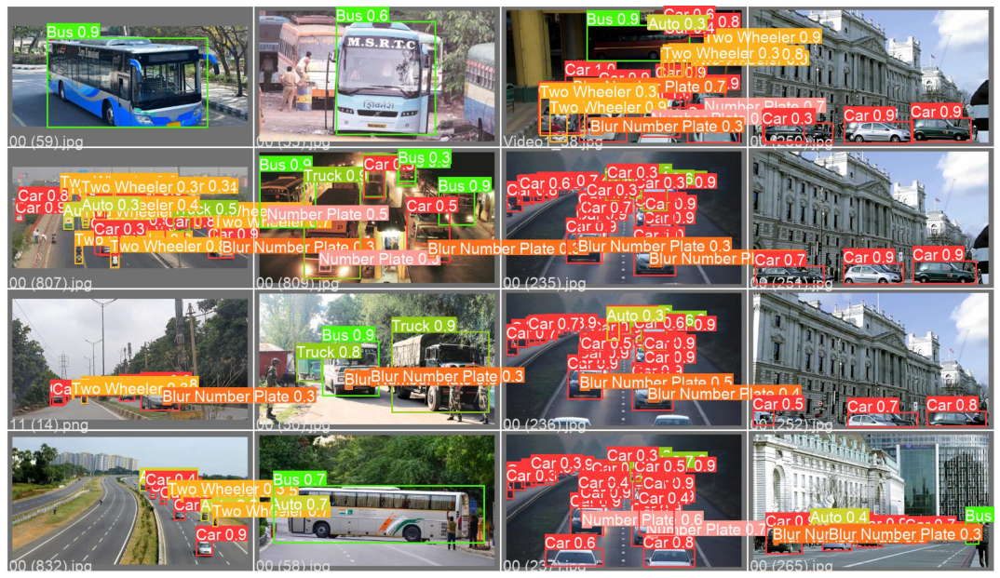

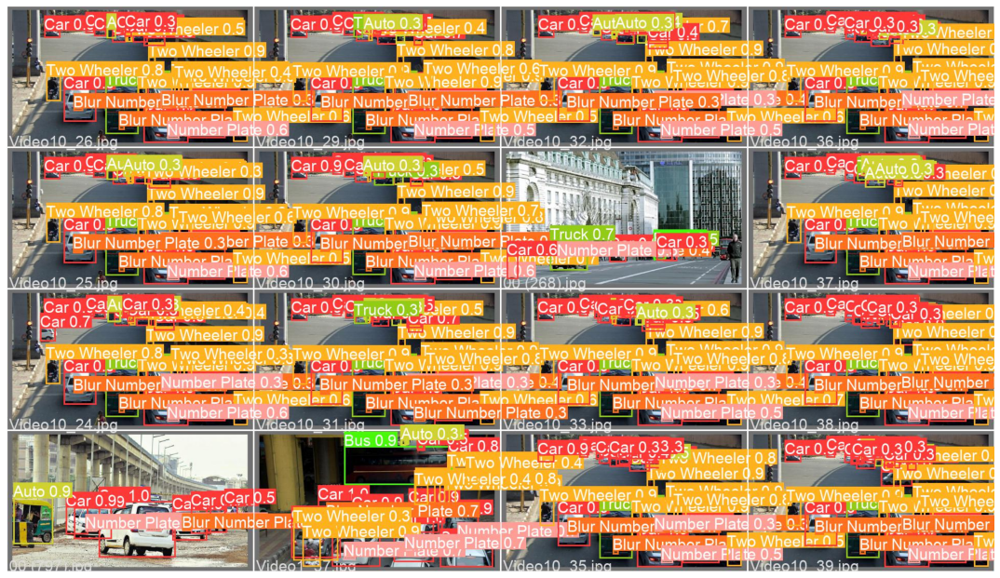

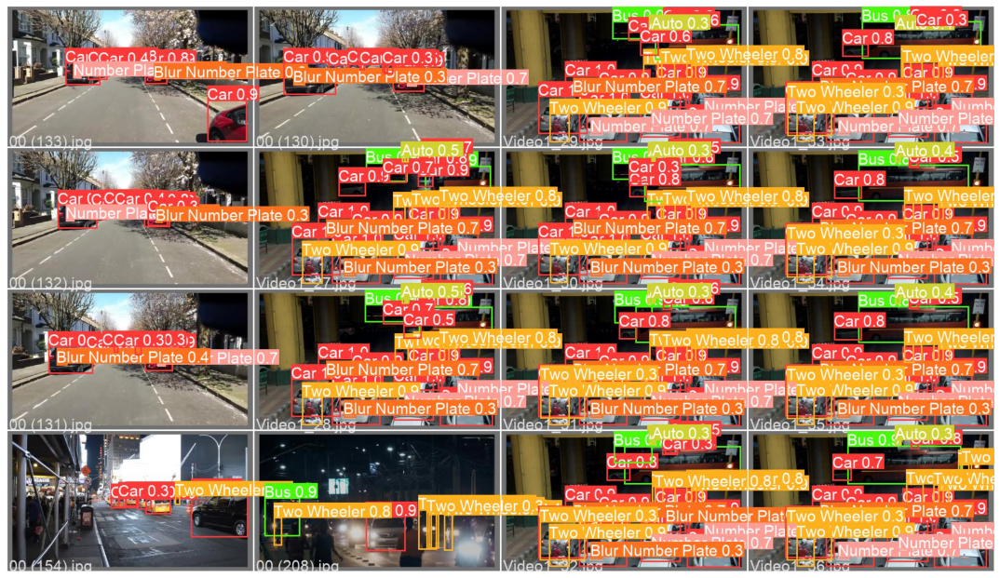

In [21]:
show_valid_results(RES_DIR)

### Inference
In this section, we will carry out inference on unseen images and videos from the internet. 

The images for inference are in the `inference_images` directory.

The videos for inference are in the `inference_videos` directory.

### Download the Images and Videos
Let's download the images and videos that we will carry inference upon.

In [22]:
download_file('https://learnopencv.s3.us-west-2.amazonaws.com/yolov5_inference_data.zip',
              'inference_data.zip')
if not os.path.exists('inference_images'):
    !unzip -q "inference_data.zip"
else:
    print('Dataset already present')

File already present, skipping download...
Dataset already present


### Inference on Images

**To carry out inference on images, we just need to provide the directory path where all the images are stored, and inference will happen on all images automatically.**

In [23]:
# Inference on images.
IMAGE_INFER_DIR = inference(RES_DIR, 'inference_images')

Current number of inference detection directories: 0
inference_1
detect: weights=['runs/train/results_1/weights/best.pt'], source=inference_images, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=inference_1, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-117-g698a5d7 torch 1.11.0 CUDA:0 (NVIDIA GeForce GTX 1060, 6078MiB)

Fusing layers... 
Model summary: 213 layers, 7029004 parameters, 0 gradients
image 1/4 /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_images/image_1.jpg: 448x640 10 Cars, 1 Auto, 6 Trucks, Done. (0.008s)
image 2/4 /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_

['runs/detect/inference_1/image_1.jpg', 'runs/detect/inference_1/image_4.jpg', 'runs/detect/inference_1/image_2.jpg', 'runs/detect/inference_1/image_3.jpg']


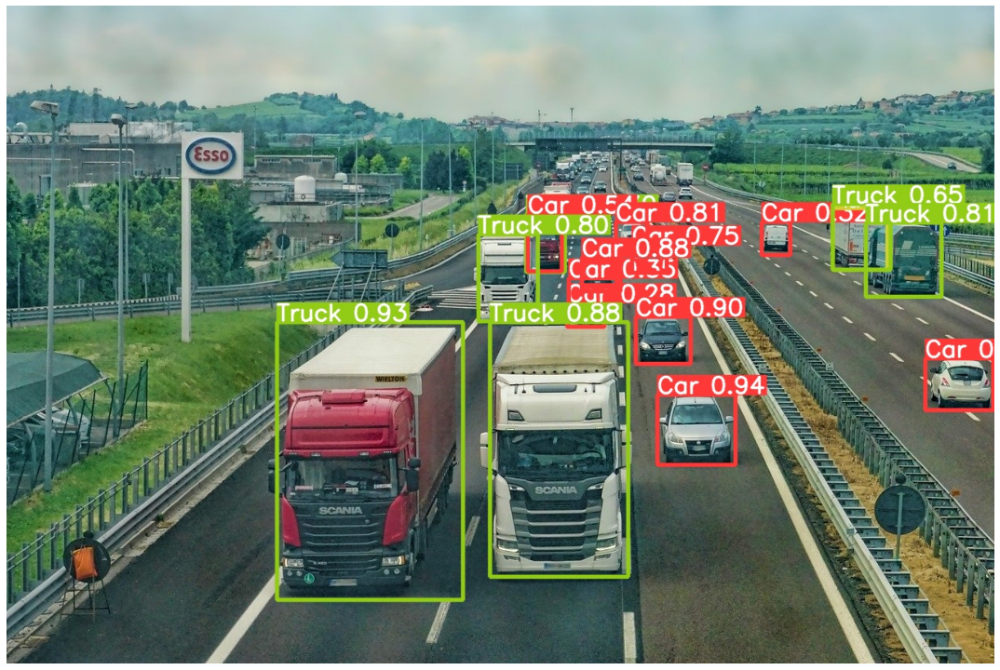

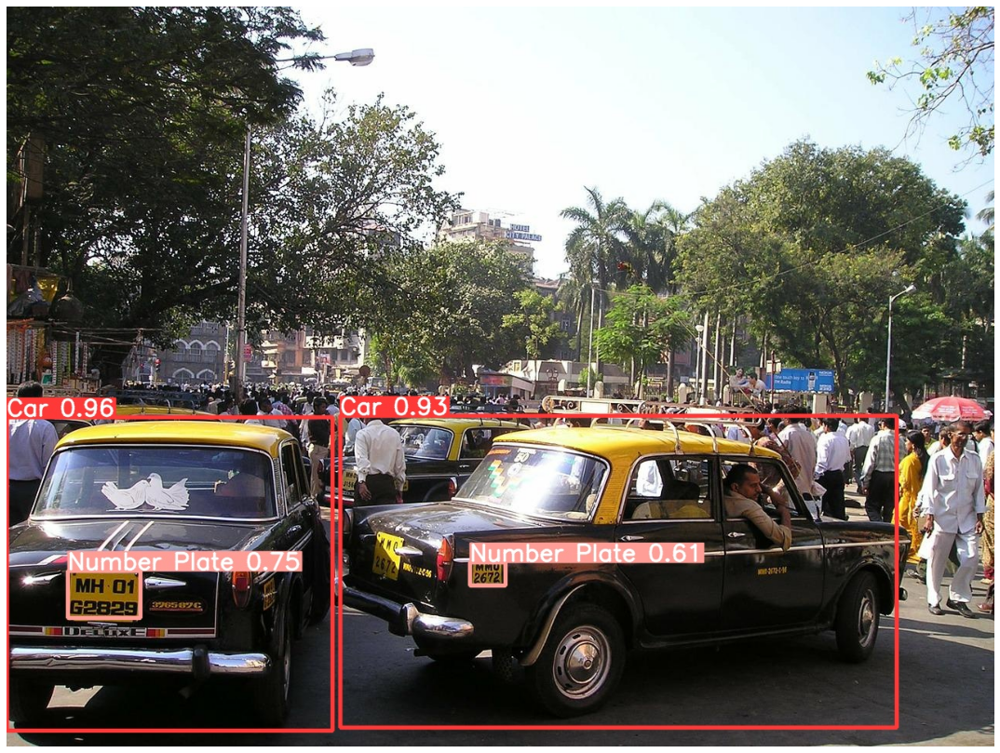

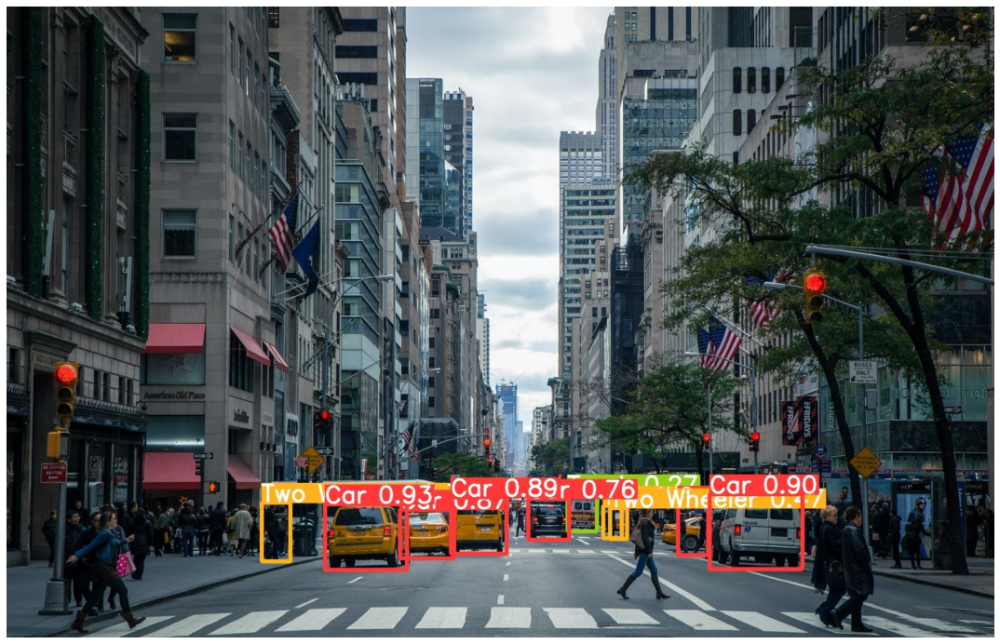

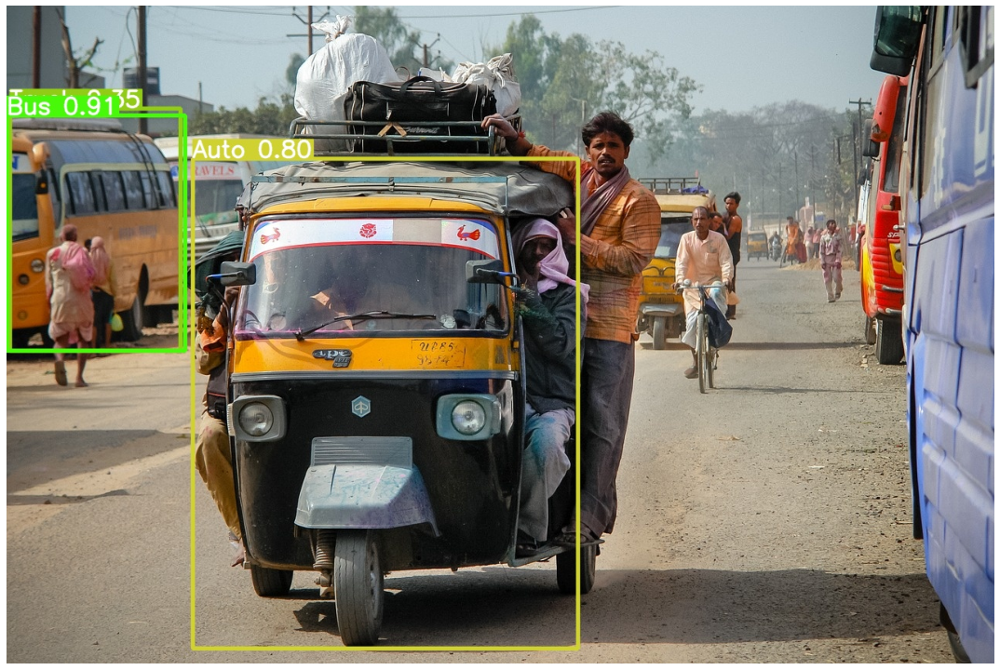

In [24]:
visualize(IMAGE_INFER_DIR)

### Inference on Videos

In [25]:
inference(RES_DIR, 'inference_videos')

Current number of inference detection directories: 1
inference_2
detect: weights=['runs/train/results_1/weights/best.pt'], source=inference_videos, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=inference_2, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-117-g698a5d7 torch 1.11.0 CUDA:0 (NVIDIA GeForce GTX 1060, 6078MiB)

Fusing layers... 
Model summary: 213 layers, 7029004 parameters, 0 gradients
video 1/4 (1/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.007s)
video 1/4 (2/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code

video 1/4 (34/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 5 Cars, 1 Number Plate, 3 Blur Number Plates, 1 Two Wheeler, 2 Buss, 1 Truck, Done. (0.007s)
video 1/4 (35/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 4 Cars, 3 Blur Number Plates, 1 Two Wheeler, 2 Buss, 1 Truck, Done. (0.007s)
video 1/4 (36/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 4 Cars, 1 Number Plate, 3 Blur Number Plates, 1 Two Wheeler, 2 Buss, 1 Truck, Done. (0.007s)
video 1/4 (37/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 3 Cars, 2 Number Plates, 1 Blur Number Plate, 1 Two Wheeler, 2 Bu

video 1/4 (67/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 4 Cars, 2 Number Plates, 1 Blur Number Plate, 1 Two Wheeler, 3 Buss, 1 Truck, Done. (0.007s)
video 1/4 (68/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 3 Cars, 2 Number Plates, 3 Blur Number Plates, 1 Two Wheeler, 2 Buss, 1 Truck, Done. (0.007s)
video 1/4 (69/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 3 Cars, 2 Number Plates, 1 Blur Number Plate, 3 Buss, 1 Truck, Done. (0.007s)
video 1/4 (70/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 3 Cars, 2 Number Plates, 2 Blur Number Plates, 3 Buss, 1 Truck,

video 1/4 (104/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 1 Car, 1 Number Plate, 2 Buss, Done. (0.007s)
video 1/4 (105/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 1 Car, 1 Number Plate, 2 Buss, Done. (0.007s)
video 1/4 (106/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 1 Car, 1 Number Plate, 2 Buss, Done. (0.007s)
video 1/4 (107/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 1 Number Plate, 2 Buss, Done. (0.007s)
video 1/4 (108/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos

video 1/4 (145/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 2 Buss, Done. (0.007s)
video 1/4 (146/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 1 Car, 2 Buss, Done. (0.007s)
video 1/4 (147/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 1 Car, 2 Buss, Done. (0.007s)
video 1/4 (148/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 1 Car, 2 Buss, Done. (0.007s)
video 1/4 (149/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 1 Car, 2 Buss, Done. (0.007s)
video 1/4 (1

video 1/4 (186/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 5 Cars, 1 Number Plate, 1 Blur Number Plate, 2 Buss, 1 Truck, Done. (0.007s)
video 1/4 (187/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 5 Cars, 1 Number Plate, 1 Blur Number Plate, 2 Buss, 1 Truck, Done. (0.007s)
video 1/4 (188/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 5 Cars, 1 Number Plate, 1 Blur Number Plate, 2 Buss, 1 Truck, Done. (0.007s)
video 1/4 (189/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 4 Cars, 3 Blur Number Plates, 2 Buss, 2 Trucks, Done. (0.007s)
video 1/4 (190/513) /home/sovi

video 1/4 (222/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 6 Cars, 2 Blur Number Plates, 1 Two Wheeler, 2 Buss, 2 Trucks, Done. (0.007s)
video 1/4 (223/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 7 Cars, 2 Blur Number Plates, 3 Buss, 2 Trucks, Done. (0.007s)
video 1/4 (224/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 8 Cars, 2 Blur Number Plates, 2 Buss, 2 Trucks, Done. (0.007s)
video 1/4 (225/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 8 Cars, 2 Blur Number Plates, 1 Auto, 2 Buss, 1 Truck, Done. (0.007s)
video 1/4 (226/513) /home/sovit/my_data/Data_Scien

video 1/4 (257/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 6 Cars, 2 Blur Number Plates, 1 Bus, 1 Truck, Done. (0.007s)
video 1/4 (258/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 6 Cars, 2 Blur Number Plates, 1 Bus, 1 Truck, Done. (0.007s)
video 1/4 (259/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 5 Cars, 3 Blur Number Plates, 1 Bus, Done. (0.007s)
video 1/4 (260/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 4 Cars, 2 Blur Number Plates, 1 Bus, Done. (0.007s)
video 1/4 (261/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_t

video 1/4 (300/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.007s)
video 1/4 (301/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.007s)
video 1/4 (302/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.007s)
video 1/4 (303/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.007s)
video 1/4 (304/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.007s)
video 1/4 (305/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_

video 1/4 (345/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.007s)
video 1/4 (346/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.007s)
video 1/4 (347/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.007s)
video 1/4 (348/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.007s)
video 1/4 (349/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.007s)
video 1/4 (350/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_

video 1/4 (392/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.007s)
video 1/4 (393/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.007s)
video 1/4 (394/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.007s)
video 1/4 (395/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.007s)
video 1/4 (396/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.007s)
video 1/4 (397/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_

video 1/4 (436/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 2 Cars, Done. (0.007s)
video 1/4 (437/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 2 Cars, 1 Truck, Done. (0.007s)
video 1/4 (438/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 3 Cars, Done. (0.007s)
video 1/4 (439/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 3 Cars, Done. (0.007s)
video 1/4 (440/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 3 Cars, Done. (0.007s)
video 1/4 (441/513) /home/sovit

video 1/4 (479/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 4 Cars, 1 Two Wheeler, Done. (0.007s)
video 1/4 (480/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 4 Cars, 1 Two Wheeler, Done. (0.007s)
video 1/4 (481/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 4 Cars, 1 Two Wheeler, Done. (0.007s)
video 1/4 (482/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 4 Cars, 1 Two Wheeler, Done. (0.007s)
video 1/4 (483/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 4 C

video 2/4 (7/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 4 Cars, 2 Number Plates, 5 Two Wheelers, Done. (0.007s)
video 2/4 (8/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 4 Cars, 1 Number Plate, 1 Blur Number Plate, 5 Two Wheelers, Done. (0.007s)
video 2/4 (9/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 3 Cars, 1 Number Plate, 1 Blur Number Plate, 4 Two Wheelers, Done. (0.007s)
video 2/4 (10/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 5 Cars, 1 Number Plate, 1 Blur Number Plate, 5 Two Wheelers, Done. (0.007s)
video 2/4 (11/610) /home/sovit/my_data/Data_Sci

video 2/4 (42/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 4 Cars, 2 Number Plates, 3 Blur Number Plates, 4 Two Wheelers, Done. (0.007s)
video 2/4 (43/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 5 Cars, 1 Number Plate, 2 Blur Number Plates, 4 Two Wheelers, Done. (0.007s)
video 2/4 (44/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 5 Cars, 1 Number Plate, 4 Two Wheelers, Done. (0.007s)
video 2/4 (45/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 5 Cars, 1 Number Plate, 2 Blur Number Plates, 4 Two Wheelers, Done. (0.007s)
video 2/4 (46/610) /home/sovit/my_data/Da

video 2/4 (79/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 2 Cars, 1 Number Plate, 1 Blur Number Plate, 4 Two Wheelers, Done. (0.007s)
video 2/4 (80/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 2 Cars, 1 Number Plate, 1 Blur Number Plate, 4 Two Wheelers, Done. (0.007s)
video 2/4 (81/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 3 Cars, 1 Number Plate, 1 Blur Number Plate, 4 Two Wheelers, Done. (0.007s)
video 2/4 (82/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 3 Cars, 1 Number Plate, 1 Blur Number Plate, 4 Two Wheelers, Done. (0.007s)
video 2/4 (83/610) /home

video 2/4 (115/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 2 Cars, 4 Two Wheelers, Done. (0.007s)
video 2/4 (116/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 2 Cars, 4 Two Wheelers, Done. (0.007s)
video 2/4 (117/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 2 Cars, 5 Two Wheelers, Done. (0.007s)
video 2/4 (118/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 2 Cars, 6 Two Wheelers, Done. (0.007s)
video 2/4 (119/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640

video 2/4 (153/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 5 Cars, 2 Blur Number Plates, 6 Two Wheelers, Done. (0.007s)
video 2/4 (154/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 4 Cars, 1 Blur Number Plate, 5 Two Wheelers, Done. (0.007s)
video 2/4 (155/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 6 Cars, 1 Blur Number Plate, 4 Two Wheelers, Done. (0.007s)
video 2/4 (156/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 8 Cars, 1 Blur Number Plate, 4 Two Wheelers, Done. (0.007s)
video 2/4 (157/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_obj

video 2/4 (191/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 2 Cars, 2 Number Plates, 5 Two Wheelers, Done. (0.007s)
video 2/4 (192/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 2 Cars, 2 Number Plates, 6 Two Wheelers, Done. (0.007s)
video 2/4 (193/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 3 Cars, 2 Number Plates, 8 Two Wheelers, Done. (0.007s)
video 2/4 (194/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 3 Cars, 2 Number Plates, 1 Blur Number Plate, 6 Two Wheelers, Done. (0.007s)
video 2/4 (195/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom

video 2/4 (229/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 4 Cars, 1 Blur Number Plate, 7 Two Wheelers, Done. (0.007s)
video 2/4 (230/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 4 Cars, 1 Blur Number Plate, 5 Two Wheelers, Done. (0.007s)
video 2/4 (231/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 4 Cars, 1 Blur Number Plate, 5 Two Wheelers, Done. (0.007s)
video 2/4 (232/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 4 Cars, 1 Blur Number Plate, 4 Two Wheelers, 1 Truck, Done. (0.007s)
video 2/4 (233/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/cu

video 2/4 (264/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 2 Cars, 8 Two Wheelers, 1 Truck, Done. (0.007s)
video 2/4 (265/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 5 Cars, 9 Two Wheelers, 1 Truck, Done. (0.007s)
video 2/4 (266/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 3 Cars, 7 Two Wheelers, 1 Truck, Done. (0.007s)
video 2/4 (267/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 4 Cars, 6 Two Wheelers, Done. (0.007s)
video 2/4 (268/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_

video 2/4 (304/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 8 Cars, 5 Two Wheelers, Done. (0.007s)
video 2/4 (305/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 5 Cars, 1 Blur Number Plate, 5 Two Wheelers, Done. (0.007s)
video 2/4 (306/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 5 Cars, 5 Two Wheelers, Done. (0.007s)
video 2/4 (307/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 6 Cars, 5 Two Wheelers, Done. (0.007s)
video 2/4 (308/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos

video 2/4 (344/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 5 Cars, 1 Blur Number Plate, 5 Two Wheelers, Done. (0.007s)
video 2/4 (345/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 4 Cars, 1 Blur Number Plate, 6 Two Wheelers, Done. (0.007s)
video 2/4 (346/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 4 Cars, 6 Two Wheelers, Done. (0.007s)
video 2/4 (347/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 5 Cars, 5 Two Wheelers, Done. (0.007s)
video 2/4 (348/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yo

video 2/4 (381/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 6 Cars, 1 Number Plate, 1 Blur Number Plate, 3 Two Wheelers, Done. (0.007s)
video 2/4 (382/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 6 Cars, 1 Number Plate, 1 Blur Number Plate, 2 Two Wheelers, Done. (0.007s)
video 2/4 (383/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 6 Cars, 1 Number Plate, 2 Two Wheelers, Done. (0.007s)
video 2/4 (384/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 7 Cars, 1 Number Plate, 1 Blur Number Plate, 2 Two Wheelers, Done. (0.007s)
video 2/4 (385/610) /home/sovit/my_data/D

video 2/4 (420/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 6 Cars, 3 Two Wheelers, Done. (0.007s)
video 2/4 (421/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 7 Cars, 1 Number Plate, 4 Two Wheelers, Done. (0.007s)
video 2/4 (422/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 5 Cars, 1 Number Plate, 1 Blur Number Plate, 5 Two Wheelers, Done. (0.007s)
video 2/4 (423/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 5 Cars, 1 Blur Number Plate, 4 Two Wheelers, Done. (0.007s)
video 2/4 (424/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detecti

video 2/4 (458/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 9 Cars, 1 Blur Number Plate, 1 Two Wheeler, Done. (0.007s)
video 2/4 (459/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 9 Cars, 1 Blur Number Plate, 1 Two Wheeler, Done. (0.007s)
video 2/4 (460/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 10 Cars, 1 Blur Number Plate, 1 Two Wheeler, Done. (0.007s)
video 2/4 (461/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 9 Cars, 1 Blur Number Plate, 3 Two Wheelers, Done. (0.007s)
video 2/4 (462/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object

video 2/4 (495/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 9 Cars, 1 Number Plate, 2 Blur Number Plates, 1 Two Wheeler, Done. (0.007s)
video 2/4 (496/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 9 Cars, 1 Number Plate, 1 Blur Number Plate, 1 Two Wheeler, Done. (0.007s)
video 2/4 (497/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 8 Cars, 1 Number Plate, 1 Blur Number Plate, 1 Two Wheeler, Done. (0.007s)
video 2/4 (498/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 8 Cars, 1 Number Plate, 2 Blur Number Plates, 2 Two Wheelers, Done. (0.007s)
video 2/4 (499/610) /

video 2/4 (531/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 6 Cars, 1 Blur Number Plate, 2 Two Wheelers, Done. (0.007s)
video 2/4 (532/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 6 Cars, 1 Blur Number Plate, 2 Two Wheelers, Done. (0.007s)
video 2/4 (533/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 6 Cars, 1 Blur Number Plate, 1 Two Wheeler, Done. (0.007s)
video 2/4 (534/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 6 Cars, 2 Blur Number Plates, 2 Two Wheelers, Done. (0.007s)
video 2/4 (535/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_obje

video 2/4 (567/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 5 Cars, 1 Blur Number Plate, 2 Two Wheelers, Done. (0.007s)
video 2/4 (568/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 5 Cars, 1 Blur Number Plate, 2 Two Wheelers, Done. (0.007s)
video 2/4 (569/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 5 Cars, 1 Blur Number Plate, 2 Two Wheelers, Done. (0.007s)
video 2/4 (570/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 6 Cars, 1 Number Plate, 1 Blur Number Plate, 3 Two Wheelers, Done. (0.007s)
video 2/4 (571/610) /home/sovit/my_data/Data_Science/Big_Vision/my_b

video 2/4 (605/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 5 Cars, 1 Number Plate, 3 Two Wheelers, Done. (0.007s)
video 2/4 (606/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 6 Cars, 1 Number Plate, Done. (0.007s)
video 2/4 (607/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 6 Cars, 1 Number Plate, 1 Two Wheeler, Done. (0.007s)
video 2/4 (608/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 6 Cars, 1 Number Plate, 1 Two Wheeler, Done. (0.007s)
video 2/4 (609/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/cod

video 3/4 (29/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 5 Cars, 1 Blur Number Plate, 7 Two Wheelers, 1 Auto, 3 Buss, 2 Trucks, Done. (0.007s)
video 3/4 (30/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 2 Cars, 2 Blur Number Plates, 5 Two Wheelers, 1 Auto, 2 Buss, 4 Trucks, Done. (0.007s)
video 3/4 (31/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 2 Cars, 1 Blur Number Plate, 6 Two Wheelers, 1 Auto, 3 Buss, 3 Trucks, Done. (0.007s)
video 3/4 (32/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 2 Cars, 1 Blur Number Plate, 7 Two Wheelers, 1 Auto, 3 Buss, 3 Trucks

video 3/4 (62/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 3 Cars, 8 Two Wheelers, 5 Buss, 3 Trucks, Done. (0.009s)
video 3/4 (63/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 3 Cars, 8 Two Wheelers, 5 Buss, 3 Trucks, Done. (0.007s)
video 3/4 (64/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 4 Cars, 7 Two Wheelers, 4 Buss, 3 Trucks, Done. (0.007s)
video 3/4 (65/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 5 Cars, 1 Blur Number Plate, 8 Two Wheelers, 1 Auto, 4 Buss, 3 Trucks, Done. (0.007s)
video 3/4 (66/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs

video 3/4 (98/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 8 Cars, 5 Two Wheelers, 1 Auto, 4 Buss, 4 Trucks, Done. (0.007s)
video 3/4 (99/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 8 Cars, 5 Two Wheelers, 1 Auto, 4 Buss, 4 Trucks, Done. (0.007s)
video 3/4 (100/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 7 Cars, 5 Two Wheelers, 1 Auto, 4 Buss, 3 Trucks, Done. (0.007s)
video 3/4 (101/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 8 Cars, 7 Two Wheelers, 1 Auto, 3 Buss, 5 Trucks, Done. (0.007s)
video 3/4 (102/246) /home/sovit/my_data/Data_Science/Big_Vision/my

video 3/4 (132/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 6 Cars, 1 Number Plate, 5 Two Wheelers, 2 Autos, 1 Bus, 2 Trucks, Done. (0.007s)
video 3/4 (133/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 6 Cars, 1 Number Plate, 5 Two Wheelers, 2 Autos, 1 Bus, 2 Trucks, Done. (0.007s)
video 3/4 (134/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 6 Cars, 1 Number Plate, 1 Blur Number Plate, 5 Two Wheelers, 2 Autos, 1 Bus, 2 Trucks, Done. (0.007s)
video 3/4 (135/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 7 Cars, 1 Number Plate, 1 Blur Number Plate, 6 Two Wheelers,

video 3/4 (164/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 7 Cars, 1 Number Plate, 1 Blur Number Plate, 5 Two Wheelers, 1 Auto, 2 Buss, 4 Trucks, Done. (0.007s)
video 3/4 (165/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 7 Cars, 1 Number Plate, 1 Blur Number Plate, 6 Two Wheelers, 1 Auto, 2 Buss, 2 Trucks, Done. (0.007s)
video 3/4 (166/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 7 Cars, 1 Number Plate, 1 Blur Number Plate, 6 Two Wheelers, 1 Auto, 2 Buss, 3 Trucks, Done. (0.007s)
video 3/4 (167/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 6 Cars, 1 Number P

video 3/4 (196/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 6 Cars, 1 Number Plate, 1 Blur Number Plate, 6 Two Wheelers, 1 Auto, 1 Bus, 5 Trucks, Done. (0.007s)
video 3/4 (197/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 5 Cars, 1 Number Plate, 1 Blur Number Plate, 6 Two Wheelers, 1 Auto, 1 Bus, 5 Trucks, Done. (0.007s)
video 3/4 (198/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 6 Cars, 1 Number Plate, 1 Blur Number Plate, 6 Two Wheelers, 1 Auto, 1 Bus, 5 Trucks, Done. (0.007s)
video 3/4 (199/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 6 Cars, 1 Number Plat

video 3/4 (228/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 4 Cars, 2 Blur Number Plates, 6 Two Wheelers, 1 Auto, 3 Buss, 3 Trucks, Done. (0.007s)
video 3/4 (229/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 4 Cars, 2 Blur Number Plates, 6 Two Wheelers, 1 Auto, 3 Buss, 3 Trucks, Done. (0.007s)
video 3/4 (230/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 5 Cars, 1 Number Plate, 2 Blur Number Plates, 6 Two Wheelers, 1 Auto, 3 Buss, 3 Trucks, Done. (0.007s)
video 3/4 (231/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 6 Cars, 1 Number Plate, 2 Blur Number Plates, 5

video 4/4 (15/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 3 Number Plates, 1 Blur Number Plate, 2 Trucks, Done. (0.007s)
video 4/4 (16/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 3 Number Plates, 1 Blur Number Plate, 2 Trucks, Done. (0.007s)
video 4/4 (17/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 3 Number Plates, 1 Blur Number Plate, 2 Trucks, Done. (0.007s)
video 4/4 (18/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 3 Number Plates, 1 Blur Number Plate, 3 Trucks, Done. (0.007s)
video 4/4 (19/1501) /home/sovit/my_d

video 4/4 (51/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 4 Number Plates, 1 Blur Number Plate, 3 Trucks, Done. (0.007s)
video 4/4 (52/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 4 Number Plates, 2 Blur Number Plates, 3 Trucks, Done. (0.007s)
video 4/4 (53/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 4 Number Plates, 3 Blur Number Plates, 4 Trucks, Done. (0.007s)
video 4/4 (54/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 4 Number Plates, 2 Blur Number Plates, 4 Trucks, Done. (0.007s)
video 4/4 (55/1501) /home/sovit/m

video 4/4 (87/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 3 Number Plates, 3 Trucks, Done. (0.007s)
video 4/4 (88/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 3 Number Plates, 3 Trucks, Done. (0.007s)
video 4/4 (89/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 3 Number Plates, 1 Blur Number Plate, 3 Trucks, Done. (0.007s)
video 4/4 (90/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 3 Number Plates, 2 Blur Number Plates, 3 Trucks, Done. (0.007s)
video 4/4 (91/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/cust

video 4/4 (124/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 2 Number Plates, 2 Blur Number Plates, 3 Trucks, Done. (0.007s)
video 4/4 (125/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 2 Number Plates, 2 Blur Number Plates, 3 Trucks, Done. (0.007s)
video 4/4 (126/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 2 Number Plates, 2 Blur Number Plates, 3 Trucks, Done. (0.007s)
video 4/4 (127/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 2 Number Plates, 1 Blur Number Plate, 3 Trucks, Done. (0.007s)
video 4/4 (128/1501) /home/so

video 4/4 (161/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 2 Number Plates, 1 Blur Number Plate, 3 Trucks, Done. (0.007s)
video 4/4 (162/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 2 Number Plates, 1 Blur Number Plate, 4 Trucks, Done. (0.007s)
video 4/4 (163/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 2 Number Plates, 2 Blur Number Plates, 3 Trucks, Done. (0.007s)
video 4/4 (164/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 2 Number Plates, 1 Blur Number Plate, 3 Trucks, Done. (0.007s)
video 4/4 (165/1501) /home/sovi

video 4/4 (197/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 2 Number Plates, 1 Blur Number Plate, 4 Trucks, Done. (0.007s)
video 4/4 (198/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 2 Number Plates, 1 Blur Number Plate, 4 Trucks, Done. (0.007s)
video 4/4 (199/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 2 Number Plates, 1 Blur Number Plate, 4 Trucks, Done. (0.007s)
video 4/4 (200/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 2 Number Plates, 1 Blur Number Plate, 4 Trucks, Done. (0.007s)
video 4/4 (201/1501) /home/sovit

video 4/4 (233/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 3 Number Plates, 4 Trucks, Done. (0.007s)
video 4/4 (234/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 3 Number Plates, 2 Blur Number Plates, 4 Trucks, Done. (0.007s)
video 4/4 (235/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 3 Number Plates, 1 Blur Number Plate, 3 Trucks, Done. (0.007s)
video 4/4 (236/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 3 Number Plates, 1 Blur Number Plate, 3 Trucks, Done. (0.007s)
video 4/4 (237/1501) /home/sovit/my_data/Data_Scienc

video 4/4 (269/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 1 Number Plate, 1 Blur Number Plate, 3 Trucks, Done. (0.007s)
video 4/4 (270/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 1 Number Plate, 2 Blur Number Plates, 3 Trucks, Done. (0.007s)
video 4/4 (271/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 1 Number Plate, 1 Blur Number Plate, 3 Trucks, Done. (0.007s)
video 4/4 (272/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 1 Number Plate, 3 Trucks, Done. (0.007s)
video 4/4 (273/1501) /home/sovit/my_data/Data_Science/Bi

video 4/4 (305/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 2 Number Plates, 1 Blur Number Plate, 4 Trucks, Done. (0.007s)
video 4/4 (306/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 2 Number Plates, 1 Blur Number Plate, 4 Trucks, Done. (0.007s)
video 4/4 (307/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 3 Number Plates, 4 Trucks, Done. (0.007s)
video 4/4 (308/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 3 Number Plates, 4 Trucks, Done. (0.007s)
video 4/4 (309/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/

video 4/4 (340/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 14 Cars, 5 Number Plates, 1 Blur Number Plate, 3 Trucks, Done. (0.007s)
video 4/4 (341/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 15 Cars, 4 Number Plates, 2 Blur Number Plates, 3 Trucks, Done. (0.007s)
video 4/4 (342/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 13 Cars, 4 Number Plates, 2 Blur Number Plates, 3 Trucks, Done. (0.007s)
video 4/4 (343/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 13 Cars, 4 Number Plates, 2 Blur Number Plates, 3 Trucks, Done. (0.007s)
video 4/4 (344/1501) /home/so

video 4/4 (376/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 12 Cars, 3 Number Plates, 2 Blur Number Plates, 3 Trucks, Done. (0.007s)
video 4/4 (377/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 12 Cars, 3 Number Plates, 2 Blur Number Plates, 3 Trucks, Done. (0.007s)
video 4/4 (378/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 13 Cars, 4 Number Plates, 2 Blur Number Plates, 3 Trucks, Done. (0.007s)
video 4/4 (379/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 12 Cars, 3 Number Plates, 2 Blur Number Plates, 3 Trucks, Done. (0.007s)
video 4/4 (380/1501) /home/s

video 4/4 (411/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 2 Number Plates, 2 Blur Number Plates, 3 Trucks, Done. (0.007s)
video 4/4 (412/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 3 Number Plates, 2 Blur Number Plates, 3 Trucks, Done. (0.007s)
video 4/4 (413/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 2 Number Plates, 2 Blur Number Plates, 3 Trucks, Done. (0.007s)
video 4/4 (414/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 3 Number Plates, 1 Blur Number Plate, 3 Trucks, Done. (0.007s)
video 4/4 (415/1501) /home/so

video 4/4 (446/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 2 Number Plates, 2 Blur Number Plates, 3 Trucks, Done. (0.007s)
video 4/4 (447/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 15 Cars, 2 Number Plates, 2 Blur Number Plates, 3 Trucks, Done. (0.007s)
video 4/4 (448/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 3 Number Plates, 2 Blur Number Plates, 3 Trucks, Done. (0.007s)
video 4/4 (449/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 15 Cars, 2 Number Plates, 1 Blur Number Plate, 2 Trucks, Done. (0.007s)
video 4/4 (450/1501) /home/so

video 4/4 (481/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 2 Number Plates, 2 Blur Number Plates, 2 Trucks, Done. (0.007s)
video 4/4 (482/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 15 Cars, 2 Number Plates, 3 Blur Number Plates, 2 Trucks, Done. (0.007s)
video 4/4 (483/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 15 Cars, 2 Number Plates, 3 Blur Number Plates, 2 Trucks, Done. (0.007s)
video 4/4 (484/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 2 Number Plates, 2 Blur Number Plates, 2 Trucks, Done. (0.007s)
video 4/4 (485/1501) /home/s

video 4/4 (516/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 2 Number Plates, 2 Blur Number Plates, 3 Trucks, Done. (0.007s)
video 4/4 (517/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 1 Number Plate, 2 Blur Number Plates, 2 Trucks, Done. (0.007s)
video 4/4 (518/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 2 Number Plates, 2 Blur Number Plates, 3 Trucks, Done. (0.007s)
video 4/4 (519/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 2 Number Plates, 2 Blur Number Plates, 3 Trucks, Done. (0.007s)
video 4/4 (520/1501) /home/so

video 4/4 (551/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 2 Number Plates, 3 Blur Number Plates, 2 Trucks, Done. (0.007s)
video 4/4 (552/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 1 Number Plate, 2 Blur Number Plates, 2 Trucks, Done. (0.007s)
video 4/4 (553/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 3 Number Plates, 2 Blur Number Plates, 2 Trucks, Done. (0.007s)
video 4/4 (554/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 3 Number Plates, 2 Blur Number Plates, 3 Trucks, Done. (0.007s)
video 4/4 (555/1501) /home/so

video 4/4 (587/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 13 Cars, 2 Number Plates, 1 Blur Number Plate, 4 Trucks, Done. (0.007s)
video 4/4 (588/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 13 Cars, 2 Number Plates, 4 Trucks, Done. (0.007s)
video 4/4 (589/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 13 Cars, 2 Number Plates, 1 Blur Number Plate, 4 Trucks, Done. (0.007s)
video 4/4 (590/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 13 Cars, 3 Number Plates, 1 Blur Number Plate, 4 Trucks, Done. (0.007s)
video 4/4 (591/1501) /home/sovit/my_data/Data_Science

video 4/4 (623/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 13 Cars, 3 Number Plates, 1 Blur Number Plate, 4 Trucks, Done. (0.007s)
video 4/4 (624/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 12 Cars, 3 Number Plates, 2 Blur Number Plates, 4 Trucks, Done. (0.007s)
video 4/4 (625/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 12 Cars, 3 Number Plates, 3 Blur Number Plates, 4 Trucks, Done. (0.007s)
video 4/4 (626/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 13 Cars, 3 Number Plates, 3 Blur Number Plates, 3 Trucks, Done. (0.007s)
video 4/4 (627/1501) /home/so

video 4/4 (657/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 14 Cars, 3 Number Plates, 1 Blur Number Plate, 5 Trucks, Done. (0.007s)
video 4/4 (658/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 14 Cars, 3 Number Plates, 1 Blur Number Plate, 5 Trucks, Done. (0.007s)
video 4/4 (659/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 15 Cars, 3 Number Plates, 2 Blur Number Plates, 5 Trucks, Done. (0.007s)
video 4/4 (660/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 3 Number Plates, 2 Blur Number Plates, 5 Trucks, Done. (0.007s)
video 4/4 (661/1501) /home/sov

video 4/4 (692/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 14 Cars, 3 Number Plates, 1 Blur Number Plate, 6 Trucks, Done. (0.007s)
video 4/4 (693/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 14 Cars, 4 Number Plates, 2 Blur Number Plates, 5 Trucks, Done. (0.007s)
video 4/4 (694/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 14 Cars, 4 Number Plates, 1 Blur Number Plate, 5 Trucks, Done. (0.007s)
video 4/4 (695/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 13 Cars, 4 Number Plates, 2 Blur Number Plates, 6 Trucks, Done. (0.007s)
video 4/4 (696/1501) /home/sov

video 4/4 (727/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 12 Cars, 3 Number Plates, 2 Blur Number Plates, 5 Trucks, Done. (0.007s)
video 4/4 (728/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 12 Cars, 3 Number Plates, 1 Blur Number Plate, 5 Trucks, Done. (0.007s)
video 4/4 (729/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 12 Cars, 2 Number Plates, 1 Blur Number Plate, 5 Trucks, Done. (0.007s)
video 4/4 (730/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 12 Cars, 2 Number Plates, 1 Blur Number Plate, 5 Trucks, Done. (0.007s)
video 4/4 (731/1501) /home/sovi

video 4/4 (762/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 15 Cars, 3 Number Plates, 1 Blur Number Plate, 4 Trucks, Done. (0.007s)
video 4/4 (763/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 15 Cars, 3 Number Plates, 4 Trucks, Done. (0.007s)
video 4/4 (764/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 15 Cars, 3 Number Plates, 1 Blur Number Plate, 4 Trucks, Done. (0.007s)
video 4/4 (765/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 14 Cars, 3 Number Plates, 1 Blur Number Plate, 4 Trucks, Done. (0.007s)
video 4/4 (766/1501) /home/sovit/my_data/Data_Science

video 4/4 (799/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 1 Number Plate, 4 Trucks, Done. (0.007s)
video 4/4 (800/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 2 Number Plates, 4 Trucks, Done. (0.007s)
video 4/4 (801/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 2 Number Plates, 4 Trucks, Done. (0.007s)
video 4/4 (802/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 1 Number Plate, 4 Trucks, Done. (0.007s)
video 4/4 (803/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov

video 4/4 (836/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 14 Cars, 1 Number Plate, 5 Trucks, Done. (0.007s)
video 4/4 (837/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 15 Cars, 1 Number Plate, 5 Trucks, Done. (0.007s)
video 4/4 (838/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 1 Number Plate, 5 Trucks, Done. (0.007s)
video 4/4 (839/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 1 Number Plate, 5 Trucks, Done. (0.007s)
video 4/4 (840/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/

video 4/4 (875/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 20 Cars, 3 Trucks, Done. (0.007s)
video 4/4 (876/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 20 Cars, 3 Trucks, Done. (0.007s)
video 4/4 (877/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 21 Cars, 3 Trucks, Done. (0.007s)
video 4/4 (878/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 22 Cars, 3 Trucks, Done. (0.007s)
video 4/4 (879/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 22 Cars, 2 Tru

video 4/4 (914/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 1 Number Plate, 1 Blur Number Plate, 3 Trucks, Done. (0.007s)
video 4/4 (915/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 1 Number Plate, 3 Trucks, Done. (0.007s)
video 4/4 (916/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 1 Number Plate, 3 Trucks, Done. (0.007s)
video 4/4 (917/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 1 Number Plate, 1 Blur Number Plate, 3 Trucks, Done. (0.007s)
video 4/4 (918/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/cust

video 4/4 (950/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 1 Number Plate, 1 Blur Number Plate, 3 Trucks, Done. (0.007s)
video 4/4 (951/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 1 Number Plate, 2 Trucks, Done. (0.007s)
video 4/4 (952/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 1 Number Plate, 2 Trucks, Done. (0.007s)
video 4/4 (953/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 1 Number Plate, 1 Blur Number Plate, 2 Trucks, Done. (0.007s)
video 4/4 (954/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/cust

video 4/4 (988/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 1 Number Plate, 3 Trucks, Done. (0.007s)
video 4/4 (989/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 1 Number Plate, 1 Blur Number Plate, 3 Trucks, Done. (0.007s)
video 4/4 (990/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 2 Number Plates, 3 Trucks, Done. (0.007s)
video 4/4 (991/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 2 Number Plates, 3 Trucks, Done. (0.007s)
video 4/4 (992/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection

video 4/4 (1025/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 20 Cars, 1 Number Plate, 1 Truck, Done. (0.007s)
video 4/4 (1026/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 1 Number Plate, 1 Blur Number Plate, 1 Truck, Done. (0.007s)
video 4/4 (1027/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 20 Cars, 1 Number Plate, 1 Blur Number Plate, 1 Truck, Done. (0.007s)
video 4/4 (1028/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 1 Number Plate, 1 Blur Number Plate, 1 Truck, Done. (0.007s)
video 4/4 (1029/1501) /home/sovit/my_data/Data_Science/Bi

video 4/4 (1063/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 1 Number Plate, 1 Truck, Done. (0.007s)
video 4/4 (1064/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 1 Number Plate, 1 Truck, Done. (0.007s)
video 4/4 (1065/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 1 Number Plate, 1 Truck, Done. (0.007s)
video 4/4 (1066/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 1 Number Plate, 1 Truck, Done. (0.007s)
video 4/4 (1067/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5

video 4/4 (1099/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 2 Number Plates, 1 Blur Number Plate, 2 Trucks, Done. (0.007s)
video 4/4 (1100/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 2 Number Plates, 1 Blur Number Plate, 1 Truck, Done. (0.007s)
video 4/4 (1101/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 2 Number Plates, 2 Blur Number Plates, 2 Trucks, Done. (0.007s)
video 4/4 (1102/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 2 Number Plates, 3 Blur Number Plates, 1 Truck, Done. (0.007s)
video 4/4 (1103/1501) /home/

video 4/4 (1135/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 3 Number Plates, 1 Blur Number Plate, 3 Trucks, Done. (0.007s)
video 4/4 (1136/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 3 Number Plates, 1 Blur Number Plate, 4 Trucks, Done. (0.007s)
video 4/4 (1137/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 3 Number Plates, 1 Blur Number Plate, 4 Trucks, Done. (0.007s)
video 4/4 (1138/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 3 Number Plates, 3 Trucks, Done. (0.007s)
video 4/4 (1139/1501) /home/sovit/my_data/Data_Sc

video 4/4 (1170/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 2 Number Plates, 2 Blur Number Plates, 1 Auto, 5 Trucks, Done. (0.007s)
video 4/4 (1171/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 20 Cars, 2 Number Plates, 2 Blur Number Plates, 1 Auto, 5 Trucks, Done. (0.007s)
video 4/4 (1172/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 2 Number Plates, 1 Blur Number Plate, 1 Auto, 5 Trucks, Done. (0.007s)
video 4/4 (1173/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 2 Number Plates, 1 Auto, 3 Trucks, Done. (0.007s)
video 4/4 (1174

video 4/4 (1207/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 1 Number Plate, 4 Trucks, Done. (0.007s)
video 4/4 (1208/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 1 Number Plate, 4 Trucks, Done. (0.007s)
video 4/4 (1209/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 1 Number Plate, 4 Trucks, Done. (0.007s)
video 4/4 (1210/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 1 Number Plate, 4 Trucks, Done. (0.007s)
video 4/4 (1211/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yo

video 4/4 (1246/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 3 Trucks, Done. (0.007s)
video 4/4 (1247/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 4 Trucks, Done. (0.007s)
video 4/4 (1248/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 3 Trucks, Done. (0.007s)
video 4/4 (1249/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 3 Trucks, Done. (0.007s)
video 4/4 (1250/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 

video 4/4 (1284/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 2 Number Plates, 4 Trucks, Done. (0.007s)
video 4/4 (1285/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 20 Cars, 2 Number Plates, 3 Trucks, Done. (0.007s)
video 4/4 (1286/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 20 Cars, 2 Number Plates, 3 Trucks, Done. (0.008s)
video 4/4 (1287/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 2 Number Plates, 3 Trucks, Done. (0.007s)
video 4/4 (1288/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_usin

video 4/4 (1322/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 1 Number Plate, 4 Trucks, Done. (0.007s)
video 4/4 (1323/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 20 Cars, 1 Number Plate, 1 Blur Number Plate, 4 Trucks, Done. (0.007s)
video 4/4 (1324/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 20 Cars, 1 Number Plate, 1 Blur Number Plate, 4 Trucks, Done. (0.007s)
video 4/4 (1325/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 20 Cars, 1 Number Plate, 1 Blur Number Plate, 1 Auto, 4 Trucks, Done. (0.007s)
video 4/4 (1326/1501) /home/sovit/my_data/Dat

video 4/4 (1357/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 3 Number Plates, 1 Blur Number Plate, 6 Trucks, Done. (0.007s)
video 4/4 (1358/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 3 Number Plates, 1 Blur Number Plate, 5 Trucks, Done. (0.007s)
video 4/4 (1359/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 3 Number Plates, 1 Blur Number Plate, 5 Trucks, Done. (0.007s)
video 4/4 (1360/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 3 Number Plates, 1 Blur Number Plate, 5 Trucks, Done. (0.007s)
video 4/4 (1361/1501) /home/

video 4/4 (1391/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 20 Cars, 1 Number Plate, 2 Blur Number Plates, 4 Trucks, Done. (0.007s)
video 4/4 (1392/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 2 Number Plates, 2 Blur Number Plates, 3 Trucks, Done. (0.007s)
video 4/4 (1393/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 2 Number Plates, 2 Blur Number Plates, 3 Trucks, Done. (0.007s)
video 4/4 (1394/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 20 Cars, 2 Number Plates, 3 Trucks, Done. (0.007s)
video 4/4 (1395/1501) /home/sovit/my_data/Data_

video 4/4 (1427/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 2 Number Plates, 2 Trucks, Done. (0.007s)
video 4/4 (1428/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 2 Number Plates, 1 Auto, 2 Trucks, Done. (0.007s)
video 4/4 (1429/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 2 Number Plates, 1 Auto, 2 Trucks, Done. (0.007s)
video 4/4 (1430/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 2 Number Plates, 1 Auto, 3 Trucks, Done. (0.007s)
video 4/4 (1431/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object

video 4/4 (1461/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 2 Number Plates, 3 Blur Number Plates, 1 Auto, 3 Trucks, Done. (0.007s)
video 4/4 (1462/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 3 Number Plates, 2 Blur Number Plates, 1 Auto, 3 Trucks, Done. (0.007s)
video 4/4 (1463/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 2 Number Plates, 1 Blur Number Plate, 1 Auto, 3 Trucks, Done. (0.007s)
video 4/4 (1464/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 20 Cars, 1 Number Plate, 1 Blur Number Plate, 1 Auto, 3 Trucks, Done. (0.0

video 4/4 (1499/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 1 Number Plate, 2 Blur Number Plates, 1 Auto, 2 Trucks, Done. (0.007s)
video 4/4 (1500/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 1 Number Plate, 1 Blur Number Plate, 1 Auto, 2 Trucks, Done. (0.007s)
video 4/4 (1501/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 1 Number Plate, 1 Blur Number Plate, 1 Auto, 2 Trucks, Done. (0.007s)
Speed: 0.3ms pre-process, 7.0ms inference, 0.8ms NMS per image at shape (1, 3, 640, 640)
Results saved to runs/detect/inference_2


'inference_2'

## Training and Inference using  Medium Model

In [26]:
monitor_tensorboard()

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 33276), started 0:13:53 ago. (Use '!kill 33276' to kill it.)

In [27]:
RES_DIR = set_res_dir()
if TRAIN:
    !python train.py --data ../data.yaml --weights yolov5m.pt \
    --img 640 --epochs {EPOCHS} --batch-size 16 --name {RES_DIR}

Current number of result directories: 1
results_2
train: weights=yolov5m.pt, cfg=, data=../data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=25, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=results_2, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: ⚠️ YOLOv5 is out of date by 10 commits. Use `git pull` or `git clone https://github.com/ultralytics/yolov5` to update.
YOLOv5 🚀 v6.1-117-g698a5d7 torch 1.11.0 CUDA:0 (NVIDIA GeForce GTX 1060, 6078MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=


     Epoch   gpu_mem       box       obj       cls    labels  img_size
      9/24      5.6G   0.03955   0.06717   0.01051        70       640: 100%|███
               Class     Images     Labels          P          R     mAP@.5 mAP@
                 all        185       1980      0.687      0.704      0.743      0.423

     Epoch   gpu_mem       box       obj       cls    labels  img_size
     10/24      5.6G   0.03815   0.06613  0.009712        54       640: 100%|███
               Class     Images     Labels          P          R     mAP@.5 mAP@
                 all        185       1980      0.765      0.736      0.773      0.437

     Epoch   gpu_mem       box       obj       cls    labels  img_size
     11/24      5.6G   0.03672   0.06373  0.009275        93       640: 100%|███
               Class     Images     Labels          P          R     mAP@.5 mAP@
                 all        185       1980      0.682      0.777       0.76      0.435

     Epoch   gpu_mem       box      

In [28]:
# Inference on images.
IMAGE_INFER_DIR = inference(RES_DIR, 'inference_images')

Current number of inference detection directories: 2
inference_3
detect: weights=['runs/train/results_2/weights/best.pt'], source=inference_images, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=inference_3, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-117-g698a5d7 torch 1.11.0 CUDA:0 (NVIDIA GeForce GTX 1060, 6078MiB)

Fusing layers... 
Model summary: 290 layers, 20877180 parameters, 0 gradients
image 1/4 /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_images/image_1.jpg: 448x640 10 Cars, 1 Blur Number Plate, 6 Trucks, Done. (0.023s)
image 2/4 /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_t

['runs/detect/inference_3/image_1.jpg', 'runs/detect/inference_3/image_4.jpg', 'runs/detect/inference_3/image_2.jpg', 'runs/detect/inference_3/image_3.jpg']


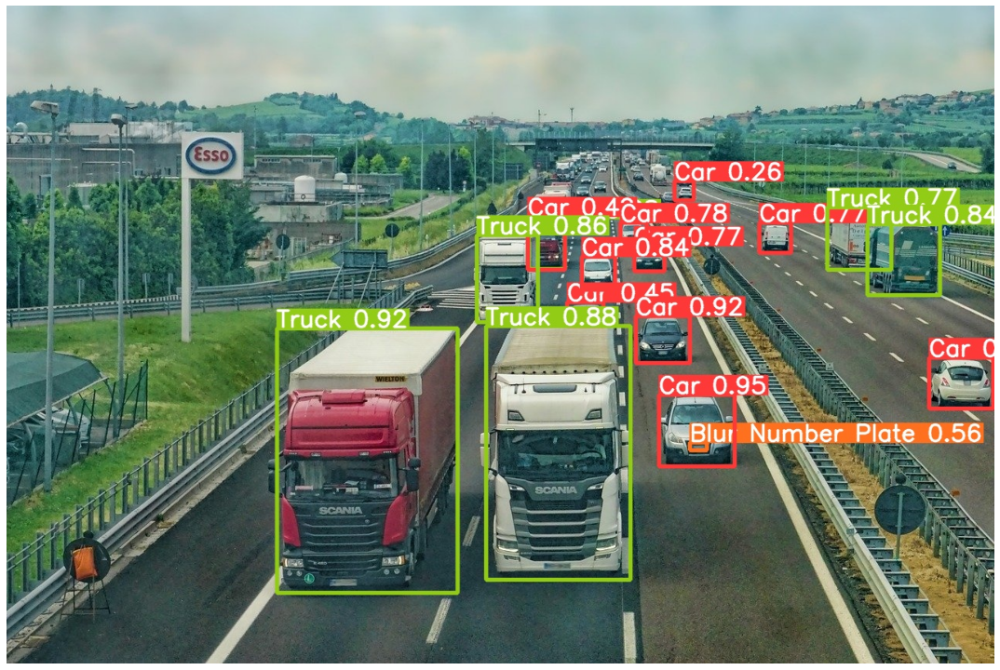

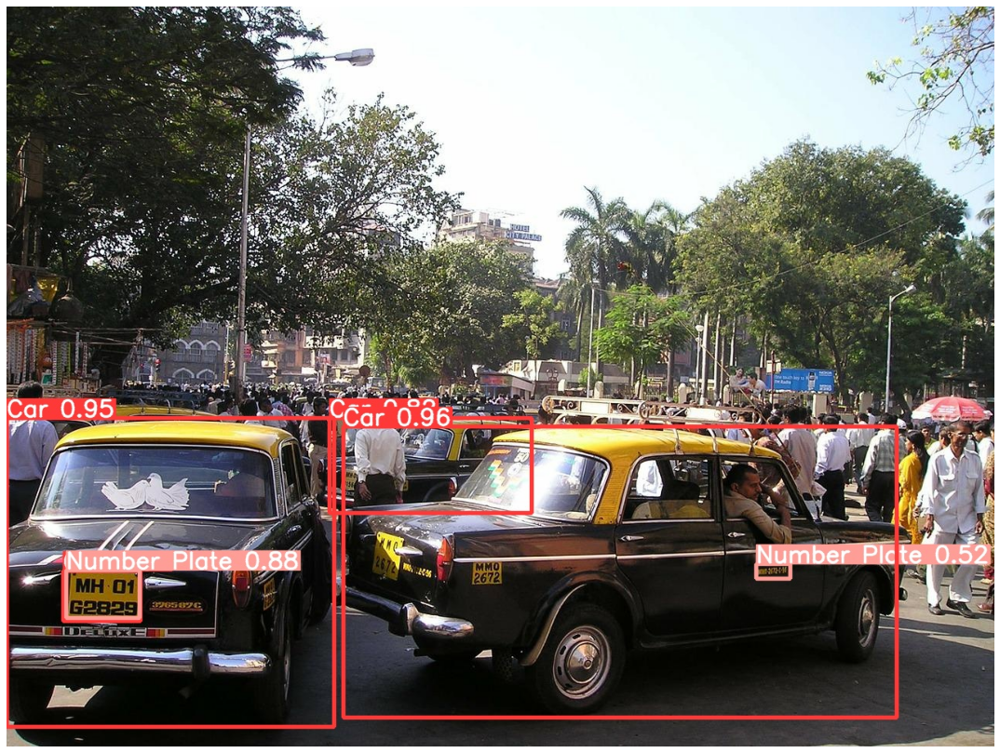

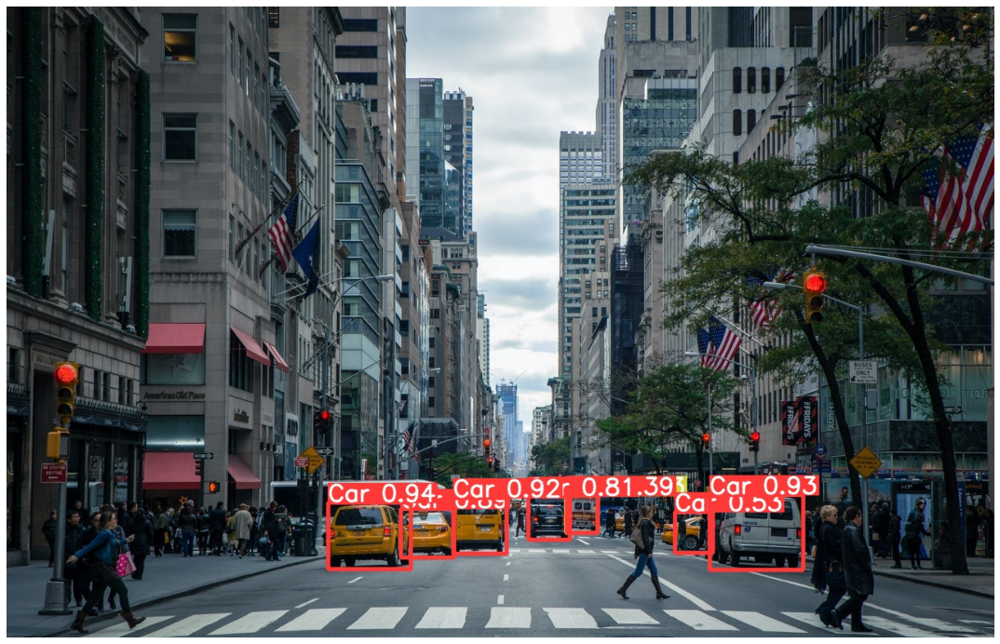

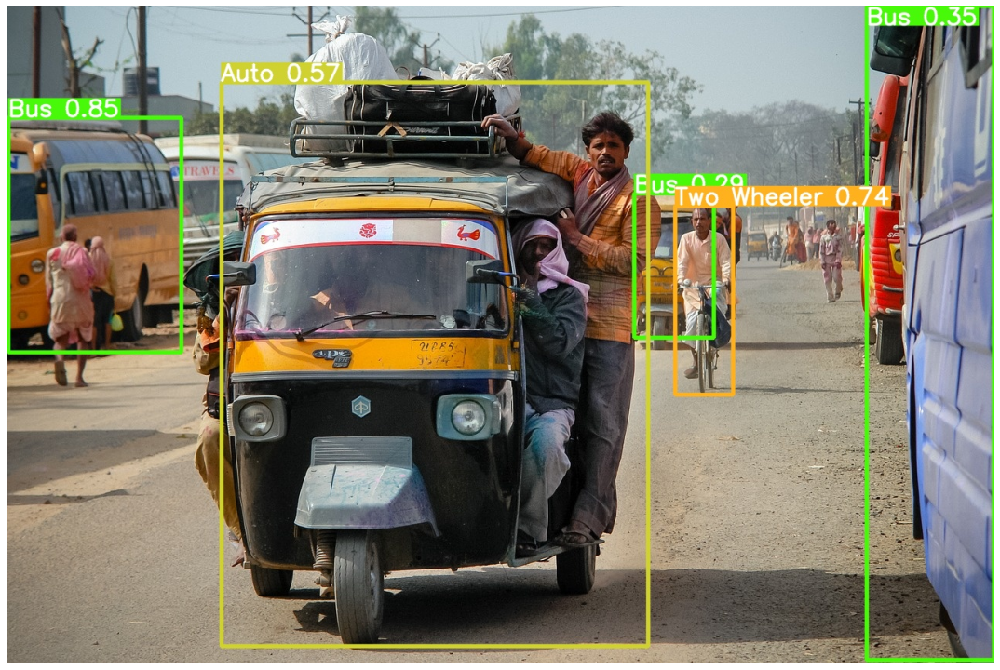

In [29]:
visualize(IMAGE_INFER_DIR)

In [30]:
inference(RES_DIR, 'inference_videos')

Current number of inference detection directories: 3
inference_4
detect: weights=['runs/train/results_2/weights/best.pt'], source=inference_videos, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=inference_4, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-117-g698a5d7 torch 1.11.0 CUDA:0 (NVIDIA GeForce GTX 1060, 6078MiB)

Fusing layers... 
Model summary: 290 layers, 20877180 parameters, 0 gradients
video 1/4 (1/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.019s)
video 1/4 (2/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/cod

video 1/4 (32/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 4 Cars, 2 Number Plates, 1 Blur Number Plate, 2 Two Wheelers, 2 Buss, 1 Truck, Done. (0.016s)
video 1/4 (33/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 5 Cars, 2 Number Plates, 2 Blur Number Plates, 2 Two Wheelers, 2 Buss, 1 Truck, Done. (0.016s)
video 1/4 (34/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 4 Cars, 2 Number Plates, 2 Blur Number Plates, 1 Two Wheeler, 2 Buss, 1 Truck, Done. (0.016s)
video 1/4 (35/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 4 Cars, 2 Number Plates, 2 Blur Number Plates

video 1/4 (65/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 2 Cars, 2 Number Plates, 3 Blur Number Plates, 2 Buss, 1 Truck, Done. (0.016s)
video 1/4 (66/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 3 Cars, 2 Number Plates, 3 Blur Number Plates, 1 Two Wheeler, 2 Buss, 1 Truck, Done. (0.016s)
video 1/4 (67/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 3 Cars, 2 Number Plates, 2 Blur Number Plates, 2 Buss, 1 Truck, Done. (0.016s)
video 1/4 (68/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 3 Cars, 2 Number Plates, 3 Blur Number Plates, 1 Two Wheeler, 2 Buss, 1 Truc

video 1/4 (99/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 1 Car, 1 Number Plate, 1 Blur Number Plate, 2 Buss, Done. (0.016s)
video 1/4 (100/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 1 Car, 1 Number Plate, 1 Blur Number Plate, 2 Buss, Done. (0.016s)
video 1/4 (101/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 1 Car, 1 Number Plate, 2 Buss, Done. (0.016s)
video 1/4 (102/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 1 Car, 1 Number Plate, 2 Buss, Done. (0.016s)
video 1/4 (103/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_tr

video 1/4 (140/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 2 Buss, Done. (0.016s)
video 1/4 (141/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 1 Two Wheeler, 2 Buss, Done. (0.016s)
video 1/4 (142/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 1 Two Wheeler, 2 Buss, Done. (0.016s)
video 1/4 (143/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 1 Two Wheeler, 2 Buss, Done. (0.016s)
video 1/4 (144/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 1 Car, 1 Two Wheel

video 1/4 (181/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 5 Cars, 1 Bus, 1 Truck, Done. (0.016s)
video 1/4 (182/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 5 Cars, 1 Bus, Done. (0.016s)
video 1/4 (183/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 5 Cars, 1 Blur Number Plate, 1 Bus, Done. (0.016s)
video 1/4 (184/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 5 Cars, 1 Blur Number Plate, 1 Bus, Done. (0.016s)
video 1/4 (185/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video

video 1/4 (218/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 5 Cars, 2 Blur Number Plates, 1 Auto, 1 Bus, Done. (0.016s)
video 1/4 (219/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 5 Cars, 1 Blur Number Plate, 1 Auto, 1 Bus, 1 Truck, Done. (0.016s)
video 1/4 (220/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 5 Cars, 3 Blur Number Plates, 1 Auto, 1 Bus, Done. (0.016s)
video 1/4 (221/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 5 Cars, 2 Blur Number Plates, 2 Autos, 1 Bus, 1 Truck, Done. (0.016s)
video 1/4 (222/513) /home/sovit/my_data/Data_Science/Big_Vision/my

video 1/4 (254/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 6 Cars, 2 Blur Number Plates, 1 Bus, 1 Truck, Done. (0.016s)
video 1/4 (255/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 6 Cars, 4 Blur Number Plates, 1 Bus, 1 Truck, Done. (0.016s)
video 1/4 (256/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 6 Cars, 2 Blur Number Plates, 1 Bus, 1 Truck, Done. (0.016s)
video 1/4 (257/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 6 Cars, 2 Blur Number Plates, 1 Bus, 1 Truck, Done. (0.015s)
video 1/4 (258/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_

video 1/4 (296/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.016s)
video 1/4 (297/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.016s)
video 1/4 (298/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.016s)
video 1/4 (299/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.016s)
video 1/4 (300/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.016s)
video 1/4 (301/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_

video 1/4 (342/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.016s)
video 1/4 (343/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.016s)
video 1/4 (344/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.016s)
video 1/4 (345/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.016s)
video 1/4 (346/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.016s)
video 1/4 (347/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_

video 1/4 (388/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.016s)
video 1/4 (389/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.016s)
video 1/4 (390/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.016s)
video 1/4 (391/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.016s)
video 1/4 (392/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.016s)
video 1/4 (393/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_

video 1/4 (433/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.016s)
video 1/4 (434/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.016s)
video 1/4 (435/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.016s)
video 1/4 (436/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 1 Car, Done. (0.016s)
video 1/4 (437/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 2 Cars, Done. (0.016s)
video 1/4 (438/513) /home/sovit/my_data/Data_Science/Big_Vision/m

video 1/4 (476/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 4 Cars, Done. (0.016s)
video 1/4 (477/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 4 Cars, Done. (0.016s)
video 1/4 (478/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 4 Cars, Done. (0.016s)
video 1/4 (479/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 4 Cars, 1 Two Wheeler, Done. (0.016s)
video 1/4 (480/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 4 Cars, 1 Two Wheeler, Done. (0.016s)
video 1/4 

video 2/4 (4/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 5 Cars, 1 Number Plate, 3 Blur Number Plates, 5 Two Wheelers, Done. (0.016s)
video 2/4 (5/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 5 Cars, 1 Number Plate, 1 Blur Number Plate, 4 Two Wheelers, Done. (0.016s)
video 2/4 (6/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 5 Cars, 1 Number Plate, 1 Blur Number Plate, 4 Two Wheelers, Done. (0.016s)
video 2/4 (7/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 5 Cars, 1 Number Plate, 2 Blur Number Plates, 5 Two Wheelers, Done. (0.016s)
video 2/4 (8/610) /home/so

video 2/4 (39/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 4 Cars, 1 Number Plate, 2 Blur Number Plates, 3 Two Wheelers, Done. (0.016s)
video 2/4 (40/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 4 Cars, 1 Number Plate, 2 Blur Number Plates, 3 Two Wheelers, Done. (0.016s)
video 2/4 (41/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 3 Cars, 2 Number Plates, 3 Blur Number Plates, 4 Two Wheelers, Done. (0.016s)
video 2/4 (42/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 4 Cars, 1 Number Plate, 2 Blur Number Plates, 4 Two Wheelers, Done. (0.016s)
video 2/4 (43/610) 

video 2/4 (77/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 2 Cars, 1 Number Plate, 2 Blur Number Plates, 4 Two Wheelers, Done. (0.016s)
video 2/4 (78/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 2 Cars, 1 Number Plate, 2 Blur Number Plates, 3 Two Wheelers, Done. (0.016s)
video 2/4 (79/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 2 Cars, 1 Number Plate, 1 Blur Number Plate, 4 Two Wheelers, Done. (0.024s)
video 2/4 (80/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 2 Cars, 1 Number Plate, 1 Blur Number Plate, 4 Two Wheelers, Done. (0.024s)
video 2/4 (81/610) /ho

video 2/4 (113/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 3 Cars, 4 Two Wheelers, Done. (0.016s)
video 2/4 (114/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 3 Cars, 3 Two Wheelers, Done. (0.016s)
video 2/4 (115/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 2 Cars, 5 Two Wheelers, Done. (0.016s)
video 2/4 (116/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 3 Cars, 4 Two Wheelers, Done. (0.016s)
video 2/4 (117/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640

video 2/4 (151/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 4 Cars, 2 Number Plates, 1 Blur Number Plate, 5 Two Wheelers, Done. (0.016s)
video 2/4 (152/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 6 Cars, 1 Number Plate, 5 Two Wheelers, Done. (0.016s)
video 2/4 (153/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 6 Cars, 1 Number Plate, 6 Two Wheelers, Done. (0.016s)
video 2/4 (154/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 6 Cars, 1 Number Plate, 1 Blur Number Plate, 5 Two Wheelers, Done. (0.016s)
video 2/4 (155/610) /home/sovit/my_data/Data_Science/Big_Visi

video 2/4 (189/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 3 Cars, 1 Number Plate, 3 Two Wheelers, Done. (0.016s)
video 2/4 (190/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 3 Cars, 1 Number Plate, 1 Blur Number Plate, 3 Two Wheelers, Done. (0.016s)
video 2/4 (191/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 5 Cars, 1 Number Plate, 1 Blur Number Plate, 3 Two Wheelers, Done. (0.016s)
video 2/4 (192/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 4 Cars, 1 Number Plate, 1 Blur Number Plate, 3 Two Wheelers, Done. (0.016s)
video 2/4 (193/610) /home/sovit/my_data/D

video 2/4 (226/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 2 Cars, 1 Blur Number Plate, 4 Two Wheelers, 1 Auto, 1 Truck, Done. (0.016s)
video 2/4 (227/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 2 Cars, 1 Blur Number Plate, 4 Two Wheelers, 1 Truck, Done. (0.016s)
video 2/4 (228/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 2 Cars, 1 Blur Number Plate, 4 Two Wheelers, 1 Truck, Done. (0.016s)
video 2/4 (229/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 2 Cars, 1 Blur Number Plate, 4 Two Wheelers, 1 Truck, Done. (0.016s)
video 2/4 (230/610) /home/sovit/my_data/

video 2/4 (260/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 2 Cars, 1 Blur Number Plate, 3 Two Wheelers, Done. (0.016s)
video 2/4 (261/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 2 Cars, 1 Number Plate, 2 Two Wheelers, Done. (0.016s)
video 2/4 (262/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 2 Cars, 1 Number Plate, 1 Blur Number Plate, 4 Two Wheelers, 1 Auto, Done. (0.016s)
video 2/4 (263/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 2 Cars, 4 Two Wheelers, Done. (0.016s)
video 2/4 (264/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object

video 2/4 (300/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 5 Cars, 1 Blur Number Plate, 4 Two Wheelers, Done. (0.016s)
video 2/4 (301/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 5 Cars, 4 Two Wheelers, Done. (0.016s)
video 2/4 (302/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 5 Cars, 4 Two Wheelers, Done. (0.016s)
video 2/4 (303/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 6 Cars, 4 Two Wheelers, Done. (0.016s)
video 2/4 (304/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos

video 2/4 (338/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 6 Cars, 1 Blur Number Plate, 2 Two Wheelers, 1 Auto, Done. (0.016s)
video 2/4 (339/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 7 Cars, 1 Blur Number Plate, 2 Two Wheelers, Done. (0.016s)
video 2/4 (340/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 7 Cars, 2 Blur Number Plates, 2 Two Wheelers, Done. (0.016s)
video 2/4 (341/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 5 Cars, 2 Blur Number Plates, 2 Two Wheelers, Done. (0.016s)
video 2/4 (342/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/c

video 2/4 (375/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 7 Cars, 1 Blur Number Plate, 2 Two Wheelers, Done. (0.016s)
video 2/4 (376/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 5 Cars, 1 Blur Number Plate, 3 Two Wheelers, Done. (0.016s)
video 2/4 (377/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 5 Cars, 1 Blur Number Plate, 2 Two Wheelers, 1 Auto, Done. (0.016s)
video 2/4 (378/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 7 Cars, 1 Blur Number Plate, 3 Two Wheelers, Done. (0.016s)
video 2/4 (379/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/cus

video 2/4 (411/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 5 Cars, 1 Blur Number Plate, 3 Two Wheelers, Done. (0.016s)
video 2/4 (412/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 6 Cars, 1 Blur Number Plate, 2 Two Wheelers, Done. (0.016s)
video 2/4 (413/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 5 Cars, 2 Two Wheelers, Done. (0.016s)
video 2/4 (414/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 6 Cars, 4 Two Wheelers, Done. (0.016s)
video 2/4 (415/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yo

video 2/4 (450/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 7 Cars, 1 Number Plate, 2 Blur Number Plates, 2 Two Wheelers, Done. (0.016s)
video 2/4 (451/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 7 Cars, 2 Blur Number Plates, 2 Two Wheelers, Done. (0.016s)
video 2/4 (452/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 6 Cars, 2 Blur Number Plates, 2 Two Wheelers, Done. (0.016s)
video 2/4 (453/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 4 Cars, 2 Blur Number Plates, 2 Two Wheelers, Done. (0.016s)
video 2/4 (454/610) /home/sovit/my_data/Data_Science/Big_Vision/

video 2/4 (485/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 6 Cars, 1 Number Plate, 1 Two Wheeler, Done. (0.016s)
video 2/4 (486/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 6 Cars, 1 Number Plate, 1 Blur Number Plate, 1 Two Wheeler, Done. (0.016s)
video 2/4 (487/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 6 Cars, 1 Number Plate, 2 Blur Number Plates, 1 Two Wheeler, Done. (0.016s)
video 2/4 (488/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 6 Cars, 1 Number Plate, 1 Two Wheeler, Done. (0.016s)
video 2/4 (489/610) /home/sovit/my_data/Data_Science/Big_Vision/m

video 2/4 (520/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 7 Cars, 1 Blur Number Plate, 1 Two Wheeler, Done. (0.016s)
video 2/4 (521/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 6 Cars, 1 Blur Number Plate, 1 Two Wheeler, Done. (0.016s)
video 2/4 (522/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 6 Cars, 1 Blur Number Plate, 1 Two Wheeler, Done. (0.016s)
video 2/4 (523/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 6 Cars, 1 Blur Number Plate, Done. (0.016s)
video 2/4 (524/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_traini

video 2/4 (559/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 5 Cars, 1 Blur Number Plate, 1 Two Wheeler, Done. (0.016s)
video 2/4 (560/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 5 Cars, 1 Blur Number Plate, 1 Two Wheeler, Done. (0.016s)
video 2/4 (561/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 5 Cars, 2 Blur Number Plates, 1 Two Wheeler, Done. (0.016s)
video 2/4 (562/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 5 Cars, 1 Blur Number Plate, Done. (0.016s)
video 2/4 (563/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_train

video 2/4 (598/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 5 Cars, 1 Number Plate, 2 Blur Number Plates, 1 Two Wheeler, Done. (0.016s)
video 2/4 (599/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 6 Cars, 1 Number Plate, 1 Blur Number Plate, 1 Two Wheeler, Done. (0.016s)
video 2/4 (600/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 7 Cars, 1 Number Plate, 2 Blur Number Plates, 1 Two Wheeler, Done. (0.016s)
video 2/4 (601/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 6 Cars, 1 Number Plate, 1 Blur Number Plate, 1 Two Wheeler, Done. (0.016s)
video 2/4 (602/610) /h

video 3/4 (23/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 6 Cars, 1 Blur Number Plate, 6 Two Wheelers, 2 Autos, 2 Buss, 3 Trucks, Done. (0.016s)
video 3/4 (24/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 6 Cars, 2 Blur Number Plates, 7 Two Wheelers, 2 Autos, 2 Buss, 3 Trucks, Done. (0.016s)
video 3/4 (25/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 4 Cars, 1 Blur Number Plate, 6 Two Wheelers, 2 Autos, 2 Buss, 3 Trucks, Done. (0.016s)
video 3/4 (26/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 4 Cars, 1 Blur Number Plate, 6 Two Wheelers, 2 Autos, 2 Buss, 3 Tr

video 3/4 (57/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 4 Cars, 8 Two Wheelers, 1 Auto, 4 Buss, 3 Trucks, Done. (0.016s)
video 3/4 (58/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 4 Cars, 2 Blur Number Plates, 8 Two Wheelers, 1 Auto, 4 Buss, 2 Trucks, Done. (0.016s)
video 3/4 (59/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 4 Cars, 2 Blur Number Plates, 8 Two Wheelers, 1 Auto, 4 Buss, 2 Trucks, Done. (0.016s)
video 3/4 (60/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 4 Cars, 1 Number Plate, 2 Blur Number Plates, 7 Two Wheelers, 1 Auto, 3 Buss, 3 Trucks, D

video 3/4 (90/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 6 Cars, 1 Blur Number Plate, 8 Two Wheelers, 2 Buss, 2 Trucks, Done. (0.016s)
video 3/4 (91/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 6 Cars, 1 Blur Number Plate, 7 Two Wheelers, 2 Buss, 2 Trucks, Done. (0.016s)
video 3/4 (92/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 6 Cars, 1 Blur Number Plate, 7 Two Wheelers, 2 Autos, 2 Buss, 2 Trucks, Done. (0.016s)
video 3/4 (93/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 6 Cars, 1 Blur Number Plate, 7 Two Wheelers, 2 Autos, 2 Buss, 2 Trucks, Done. (0.016s

video 3/4 (124/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 6 Cars, 1 Number Plate, 5 Two Wheelers, 1 Auto, 1 Bus, 3 Trucks, Done. (0.016s)
video 3/4 (125/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 5 Cars, 1 Number Plate, 6 Two Wheelers, 1 Auto, 2 Buss, 3 Trucks, Done. (0.016s)
video 3/4 (126/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 5 Cars, 1 Number Plate, 6 Two Wheelers, 1 Auto, 2 Buss, 3 Trucks, Done. (0.016s)
video 3/4 (127/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 4 Cars, 1 Number Plate, 6 Two Wheelers, 1 Auto, 1 Bus, 3 Trucks, Done. (0.016s)
vi

video 3/4 (156/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 5 Cars, 1 Number Plate, 1 Blur Number Plate, 6 Two Wheelers, 3 Autos, 1 Bus, 2 Trucks, Done. (0.016s)
video 3/4 (157/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 5 Cars, 1 Number Plate, 1 Blur Number Plate, 6 Two Wheelers, 3 Autos, 1 Bus, 3 Trucks, Done. (0.016s)
video 3/4 (158/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 5 Cars, 1 Number Plate, 6 Two Wheelers, 3 Autos, 2 Buss, 2 Trucks, Done. (0.016s)
video 3/4 (159/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 5 Cars, 1 Number Plate, 6 Two Wheelers

video 3/4 (189/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 6 Cars, 1 Number Plate, 1 Blur Number Plate, 6 Two Wheelers, 1 Auto, 2 Buss, 1 Truck, Done. (0.016s)
video 3/4 (190/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 6 Cars, 1 Number Plate, 1 Blur Number Plate, 5 Two Wheelers, 2 Autos, 2 Buss, 1 Truck, Done. (0.016s)
video 3/4 (191/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 6 Cars, 1 Number Plate, 1 Blur Number Plate, 6 Two Wheelers, 1 Auto, 1 Bus, 1 Truck, Done. (0.016s)
video 3/4 (192/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 4 Cars, 1 Number Plat

video 3/4 (221/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 6 Cars, 1 Number Plate, 2 Blur Number Plates, 6 Two Wheelers, 1 Auto, 2 Buss, 2 Trucks, Done. (0.016s)
video 3/4 (222/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 4 Cars, 1 Number Plate, 2 Blur Number Plates, 6 Two Wheelers, 1 Auto, 2 Buss, 2 Trucks, Done. (0.016s)
video 3/4 (223/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 4 Cars, 1 Number Plate, 2 Blur Number Plates, 6 Two Wheelers, 1 Auto, 2 Buss, 2 Trucks, Done. (0.016s)
video 3/4 (224/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 5 Cars, 1 Numbe

video 4/4 (8/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 4 Number Plates, 3 Trucks, Done. (0.016s)
video 4/4 (9/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 5 Number Plates, 2 Trucks, Done. (0.016s)
video 4/4 (10/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 5 Number Plates, 2 Trucks, Done. (0.016s)
video 4/4 (11/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 4 Number Plates, 2 Trucks, Done. (0.016s)
video 4/4 (12/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/cod

video 4/4 (45/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 3 Number Plates, 1 Blur Number Plate, 3 Trucks, Done. (0.016s)
video 4/4 (46/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 3 Number Plates, 2 Blur Number Plates, 3 Trucks, Done. (0.016s)
video 4/4 (47/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 3 Number Plates, 2 Blur Number Plates, 3 Trucks, Done. (0.016s)
video 4/4 (48/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 20 Cars, 4 Number Plates, 1 Blur Number Plate, 2 Trucks, Done. (0.016s)
video 4/4 (49/1501) /home/sovit/my

video 4/4 (82/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 3 Number Plates, 1 Blur Number Plate, 3 Trucks, Done. (0.016s)
video 4/4 (83/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 3 Number Plates, 1 Blur Number Plate, 3 Trucks, Done. (0.016s)
video 4/4 (84/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 3 Number Plates, 3 Trucks, Done. (0.016s)
video 4/4 (85/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 3 Number Plates, 3 Trucks, Done. (0.016s)
video 4/4 (86/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custo

video 4/4 (118/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 3 Number Plates, 1 Blur Number Plate, 4 Trucks, Done. (0.016s)
video 4/4 (119/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 3 Number Plates, 1 Blur Number Plate, 4 Trucks, Done. (0.016s)
video 4/4 (120/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 3 Number Plates, 1 Blur Number Plate, 4 Trucks, Done. (0.016s)
video 4/4 (121/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 3 Number Plates, 4 Trucks, Done. (0.016s)
video 4/4 (122/1501) /home/sovit/my_data/Data_Science

video 4/4 (156/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 2 Number Plates, 3 Trucks, Done. (0.016s)
video 4/4 (157/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 2 Number Plates, 3 Trucks, Done. (0.016s)
video 4/4 (158/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 2 Number Plates, 3 Trucks, Done. (0.016s)
video 4/4 (159/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 2 Number Plates, 3 Trucks, Done. (0.016s)
video 4/4 (160/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yol

video 4/4 (193/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 2 Number Plates, 4 Trucks, Done. (0.016s)
video 4/4 (194/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 2 Number Plates, 4 Trucks, Done. (0.016s)
video 4/4 (195/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 2 Number Plates, 4 Trucks, Done. (0.016s)
video 4/4 (196/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 2 Number Plates, 4 Trucks, Done. (0.016s)
video 4/4 (197/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yol

video 4/4 (229/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 3 Number Plates, 3 Trucks, Done. (0.016s)
video 4/4 (230/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 3 Number Plates, 3 Trucks, Done. (0.016s)
video 4/4 (231/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 3 Number Plates, 1 Blur Number Plate, 3 Trucks, Done. (0.016s)
video 4/4 (232/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 3 Number Plates, 3 Trucks, Done. (0.016s)
video 4/4 (233/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detecti

video 4/4 (266/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 1 Number Plate, 2 Trucks, Done. (0.016s)
video 4/4 (267/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 1 Number Plate, 2 Trucks, Done. (0.016s)
video 4/4 (268/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 1 Number Plate, 2 Trucks, Done. (0.016s)
video 4/4 (269/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 1 Number Plate, 2 Trucks, Done. (0.016s)
video 4/4 (270/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/

video 4/4 (305/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 15 Cars, 3 Number Plates, 4 Trucks, Done. (0.016s)
video 4/4 (306/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 3 Number Plates, 4 Trucks, Done. (0.016s)
video 4/4 (307/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 3 Number Plates, 4 Trucks, Done. (0.016s)
video 4/4 (308/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 3 Number Plates, 4 Trucks, Done. (0.016s)
video 4/4 (309/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yol

video 4/4 (341/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 14 Cars, 5 Number Plates, 1 Blur Number Plate, 3 Trucks, Done. (0.016s)
video 4/4 (342/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 14 Cars, 4 Number Plates, 2 Blur Number Plates, 3 Trucks, Done. (0.016s)
video 4/4 (343/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 14 Cars, 4 Number Plates, 1 Blur Number Plate, 3 Trucks, Done. (0.016s)
video 4/4 (344/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 14 Cars, 4 Number Plates, 2 Blur Number Plates, 3 Trucks, Done. (0.016s)
video 4/4 (345/1501) /home/sov

video 4/4 (376/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 15 Cars, 3 Number Plates, 1 Blur Number Plate, 3 Trucks, Done. (0.016s)
video 4/4 (377/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 15 Cars, 3 Number Plates, 1 Blur Number Plate, 3 Trucks, Done. (0.016s)
video 4/4 (378/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 15 Cars, 3 Number Plates, 1 Blur Number Plate, 3 Trucks, Done. (0.016s)
video 4/4 (379/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 3 Number Plates, 2 Blur Number Plates, 3 Trucks, Done. (0.016s)
video 4/4 (380/1501) /home/sovi

video 4/4 (410/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 3 Number Plates, 1 Blur Number Plate, 3 Trucks, Done. (0.016s)
video 4/4 (411/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 2 Number Plates, 1 Blur Number Plate, 3 Trucks, Done. (0.016s)
video 4/4 (412/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 2 Number Plates, 1 Blur Number Plate, 3 Trucks, Done. (0.016s)
video 4/4 (413/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 2 Number Plates, 2 Blur Number Plates, 3 Trucks, Done. (0.016s)
video 4/4 (414/1501) /home/sovi

video 4/4 (444/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 20 Cars, 2 Number Plates, 1 Blur Number Plate, 3 Trucks, Done. (0.016s)
video 4/4 (445/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 20 Cars, 3 Number Plates, 2 Blur Number Plates, 3 Trucks, Done. (0.017s)
video 4/4 (446/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 20 Cars, 2 Number Plates, 2 Blur Number Plates, 3 Trucks, Done. (0.016s)
video 4/4 (447/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 20 Cars, 2 Number Plates, 1 Blur Number Plate, 3 Trucks, Done. (0.016s)
video 4/4 (448/1501) /home/sov

video 4/4 (479/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 14 Cars, 3 Number Plates, 2 Blur Number Plates, 2 Trucks, Done. (0.016s)
video 4/4 (480/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 14 Cars, 3 Number Plates, 2 Blur Number Plates, 2 Trucks, Done. (0.016s)
video 4/4 (481/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 14 Cars, 3 Number Plates, 3 Blur Number Plates, 2 Trucks, Done. (0.016s)
video 4/4 (482/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 14 Cars, 3 Number Plates, 2 Blur Number Plates, 2 Trucks, Done. (0.016s)
video 4/4 (483/1501) /home/s

video 4/4 (513/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 2 Number Plates, 2 Blur Number Plates, 2 Trucks, Done. (0.016s)
video 4/4 (514/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 2 Number Plates, 1 Blur Number Plate, 2 Trucks, Done. (0.017s)
video 4/4 (515/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 2 Number Plates, 2 Blur Number Plates, 2 Trucks, Done. (0.016s)
video 4/4 (516/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 2 Number Plates, 1 Blur Number Plate, 2 Trucks, Done. (0.017s)
video 4/4 (517/1501) /home/sov

video 4/4 (548/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 14 Cars, 3 Number Plates, 1 Blur Number Plate, 3 Trucks, Done. (0.016s)
video 4/4 (549/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 13 Cars, 3 Number Plates, 1 Blur Number Plate, 3 Trucks, Done. (0.016s)
video 4/4 (550/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 13 Cars, 3 Number Plates, 2 Blur Number Plates, 3 Trucks, Done. (0.016s)
video 4/4 (551/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 14 Cars, 3 Number Plates, 1 Blur Number Plate, 3 Trucks, Done. (0.016s)
video 4/4 (552/1501) /home/sovi

video 4/4 (583/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 13 Cars, 2 Number Plates, 1 Blur Number Plate, 4 Trucks, Done. (0.016s)
video 4/4 (584/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 12 Cars, 2 Number Plates, 1 Blur Number Plate, 4 Trucks, Done. (0.016s)
video 4/4 (585/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 12 Cars, 3 Number Plates, 1 Blur Number Plate, 4 Trucks, Done. (0.016s)
video 4/4 (586/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 12 Cars, 2 Number Plates, 1 Blur Number Plate, 5 Trucks, Done. (0.016s)
video 4/4 (587/1501) /home/sovit

video 4/4 (618/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 9 Cars, 4 Number Plates, 2 Blur Number Plates, 4 Trucks, Done. (0.016s)
video 4/4 (619/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 10 Cars, 4 Number Plates, 3 Blur Number Plates, 5 Trucks, Done. (0.016s)
video 4/4 (620/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 9 Cars, 3 Number Plates, 1 Blur Number Plate, 5 Trucks, Done. (0.016s)
video 4/4 (621/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 10 Cars, 3 Number Plates, 1 Blur Number Plate, 5 Trucks, Done. (0.016s)
video 4/4 (622/1501) /home/sovit

video 4/4 (656/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 11 Cars, 4 Number Plates, 1 Blur Number Plate, 4 Trucks, Done. (0.016s)
video 4/4 (657/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 11 Cars, 4 Number Plates, 2 Blur Number Plates, 4 Trucks, Done. (0.016s)
video 4/4 (658/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 11 Cars, 4 Number Plates, 2 Blur Number Plates, 3 Trucks, Done. (0.016s)
video 4/4 (659/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 10 Cars, 4 Number Plates, 1 Blur Number Plate, 4 Trucks, Done. (0.016s)
video 4/4 (660/1501) /home/sov

video 4/4 (694/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 12 Cars, 4 Number Plates, 1 Blur Number Plate, 4 Trucks, Done. (0.016s)
video 4/4 (695/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 12 Cars, 4 Number Plates, 1 Blur Number Plate, 4 Trucks, Done. (0.016s)
video 4/4 (696/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 13 Cars, 4 Number Plates, 1 Blur Number Plate, 4 Trucks, Done. (0.016s)
video 4/4 (697/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 13 Cars, 4 Number Plates, 1 Blur Number Plate, 4 Trucks, Done. (0.016s)
video 4/4 (698/1501) /home/sovit

video 4/4 (731/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 13 Cars, 3 Number Plates, 1 Blur Number Plate, 4 Trucks, Done. (0.016s)
video 4/4 (732/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 12 Cars, 3 Number Plates, 1 Blur Number Plate, 4 Trucks, Done. (0.016s)
video 4/4 (733/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 13 Cars, 3 Number Plates, 1 Blur Number Plate, 4 Trucks, Done. (0.016s)
video 4/4 (734/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 14 Cars, 3 Number Plates, 4 Trucks, Done. (0.016s)
video 4/4 (735/1501) /home/sovit/my_data/Data_Science

video 4/4 (769/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 13 Cars, 2 Number Plates, 4 Trucks, Done. (0.016s)
video 4/4 (770/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 13 Cars, 2 Number Plates, 4 Trucks, Done. (0.016s)
video 4/4 (771/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 14 Cars, 2 Number Plates, 4 Trucks, Done. (0.016s)
video 4/4 (772/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 14 Cars, 2 Number Plates, 4 Trucks, Done. (0.017s)
video 4/4 (773/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yol

video 4/4 (808/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 1 Number Plate, 4 Trucks, Done. (0.016s)
video 4/4 (809/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 1 Number Plate, 4 Trucks, Done. (0.016s)
video 4/4 (810/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 1 Number Plate, 4 Trucks, Done. (0.016s)
video 4/4 (811/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 1 Number Plate, 4 Trucks, Done. (0.016s)
video 4/4 (812/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/

video 4/4 (846/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 14 Cars, 1 Number Plate, 4 Trucks, Done. (0.016s)
video 4/4 (847/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 15 Cars, 1 Number Plate, 4 Trucks, Done. (0.016s)
video 4/4 (848/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 1 Number Plate, 1 Auto, 4 Trucks, Done. (0.016s)
video 4/4 (849/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 1 Number Plate, 1 Auto, 4 Trucks, Done. (0.016s)
video 4/4 (850/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_traini

video 4/4 (885/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 21 Cars, 2 Trucks, Done. (0.016s)
video 4/4 (886/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 21 Cars, 3 Trucks, Done. (0.016s)
video 4/4 (887/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 21 Cars, 3 Trucks, Done. (0.016s)
video 4/4 (888/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 21 Cars, 2 Trucks, Done. (0.016s)
video 4/4 (889/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 21 Cars, 2 Tru

video 4/4 (925/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 1 Number Plate, 1 Blur Number Plate, 1 Truck, Done. (0.016s)
video 4/4 (926/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 20 Cars, 1 Number Plate, 1 Truck, Done. (0.016s)
video 4/4 (927/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 1 Number Plate, 1 Truck, Done. (0.016s)
video 4/4 (928/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 1 Number Plate, 1 Truck, Done. (0.016s)
video 4/4 (929/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_train

video 4/4 (962/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 2 Number Plates, 1 Blur Number Plate, 1 Truck, Done. (0.016s)
video 4/4 (963/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 2 Number Plates, 1 Truck, Done. (0.016s)
video 4/4 (964/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 2 Number Plates, 1 Blur Number Plate, 1 Truck, Done. (0.028s)
video 4/4 (965/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 2 Number Plates, 1 Blur Number Plate, 1 Truck, Done. (0.016s)
video 4/4 (966/1501) /home/sovit/my_data/Data_Science/Big

video 4/4 (1000/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 1 Number Plate, 1 Truck, Done. (0.016s)
video 4/4 (1001/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 1 Number Plate, 1 Truck, Done. (0.016s)
video 4/4 (1002/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 1 Number Plate, 1 Blur Number Plate, 1 Truck, Done. (0.016s)
video 4/4 (1003/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 1 Number Plate, 1 Blur Number Plate, 1 Truck, Done. (0.016s)
video 4/4 (1004/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/cus

video 4/4 (1038/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 1 Number Plate, 1 Truck, Done. (0.016s)
video 4/4 (1039/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 1 Number Plate, 1 Truck, Done. (0.016s)
video 4/4 (1040/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 1 Number Plate, 1 Truck, Done. (0.016s)
video 4/4 (1041/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 1 Number Plate, 1 Truck, Done. (0.016s)
video 4/4 (1042/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5

video 4/4 (1076/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 2 Number Plates, 1 Truck, Done. (0.016s)
video 4/4 (1077/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 1 Number Plate, 1 Blur Number Plate, 1 Truck, Done. (0.016s)
video 4/4 (1078/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 2 Number Plates, 1 Truck, Done. (0.016s)
video 4/4 (1079/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 3 Number Plates, 1 Blur Number Plate, 1 Truck, Done. (0.016s)
video 4/4 (1080/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/

video 4/4 (1113/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 3 Number Plates, 1 Truck, Done. (0.016s)
video 4/4 (1114/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 3 Number Plates, 1 Truck, Done. (0.016s)
video 4/4 (1115/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 20 Cars, 3 Number Plates, 1 Blur Number Plate, 1 Truck, Done. (0.016s)
video 4/4 (1116/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 3 Number Plates, 1 Truck, Done. (0.016s)
video 4/4 (1117/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detect

video 4/4 (1150/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 20 Cars, 2 Number Plates, 1 Truck, Done. (0.016s)
video 4/4 (1151/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 20 Cars, 2 Number Plates, 1 Truck, Done. (0.016s)
video 4/4 (1152/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 21 Cars, 2 Number Plates, 1 Truck, Done. (0.016s)
video 4/4 (1153/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 22 Cars, 2 Number Plates, 1 Truck, Done. (0.016s)
video 4/4 (1154/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yo

video 4/4 (1188/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 21 Cars, 2 Number Plates, 3 Trucks, Done. (0.016s)
video 4/4 (1189/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 20 Cars, 2 Number Plates, 3 Trucks, Done. (0.016s)
video 4/4 (1190/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 20 Cars, 2 Number Plates, 4 Trucks, Done. (0.016s)
video 4/4 (1191/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 20 Cars, 2 Number Plates, 4 Trucks, Done. (0.016s)
video 4/4 (1192/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_usin

video 4/4 (1227/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 3 Trucks, Done. (0.016s)
video 4/4 (1228/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 3 Trucks, Done. (0.016s)
video 4/4 (1229/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 3 Trucks, Done. (0.016s)
video 4/4 (1230/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 3 Trucks, Done. (0.016s)
video 4/4 (1231/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 

video 4/4 (1265/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 1 Number Plate, 1 Blur Number Plate, 3 Trucks, Done. (0.016s)
video 4/4 (1266/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 1 Number Plate, 3 Trucks, Done. (0.016s)
video 4/4 (1267/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 1 Number Plate, 3 Trucks, Done. (0.016s)
video 4/4 (1268/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 1 Number Plate, 1 Blur Number Plate, 3 Trucks, Done. (0.016s)
video 4/4 (1269/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs

video 4/4 (1302/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 2 Number Plates, 2 Trucks, Done. (0.016s)
video 4/4 (1303/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 2 Number Plates, 2 Trucks, Done. (0.016s)
video 4/4 (1304/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 2 Number Plates, 2 Trucks, Done. (0.016s)
video 4/4 (1305/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 2 Number Plates, 2 Trucks, Done. (0.016s)
video 4/4 (1306/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_usin

video 4/4 (1337/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 20 Cars, 2 Number Plates, 1 Blur Number Plate, 2 Trucks, Done. (0.016s)
video 4/4 (1338/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 20 Cars, 2 Number Plates, 1 Blur Number Plate, 1 Truck, Done. (0.016s)
video 4/4 (1339/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 2 Number Plates, 1 Blur Number Plate, 1 Truck, Done. (0.016s)
video 4/4 (1340/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 2 Number Plates, 1 Blur Number Plate, 1 Truck, Done. (0.016s)
video 4/4 (1341/1501) /home/sov

video 4/4 (1371/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 2 Number Plates, 1 Blur Number Plate, 3 Trucks, Done. (0.016s)
video 4/4 (1372/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 2 Number Plates, 1 Blur Number Plate, 3 Trucks, Done. (0.016s)
video 4/4 (1373/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 1 Number Plate, 1 Blur Number Plate, 2 Trucks, Done. (0.016s)
video 4/4 (1374/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 2 Number Plates, 1 Blur Number Plate, 2 Trucks, Done. (0.016s)
video 4/4 (1375/1501) /home/s

video 4/4 (1407/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 2 Number Plates, 3 Trucks, Done. (0.016s)
video 4/4 (1408/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 2 Number Plates, 1 Blur Number Plate, 3 Trucks, Done. (0.016s)
video 4/4 (1409/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 2 Number Plates, 1 Blur Number Plate, 3 Trucks, Done. (0.016s)
video 4/4 (1410/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 2 Number Plates, 1 Blur Number Plate, 3 Trucks, Done. (0.016s)
video 4/4 (1411/1501) /home/sovit/my_data/Data_Sc

video 4/4 (1443/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 3 Number Plates, 2 Blur Number Plates, 3 Trucks, Done. (0.016s)
video 4/4 (1444/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 3 Number Plates, 1 Blur Number Plate, 3 Trucks, Done. (0.016s)
video 4/4 (1445/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 20 Cars, 3 Number Plates, 2 Blur Number Plates, 3 Trucks, Done. (0.016s)
video 4/4 (1446/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 3 Number Plates, 2 Blur Number Plates, 3 Trucks, Done. (0.016s)
video 4/4 (1447/1501) /ho

video 4/4 (1479/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 21 Cars, 2 Number Plates, 1 Blur Number Plate, 2 Trucks, Done. (0.016s)
video 4/4 (1480/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 20 Cars, 2 Number Plates, 2 Trucks, Done. (0.016s)
video 4/4 (1481/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 20 Cars, 2 Number Plates, 1 Blur Number Plate, 2 Trucks, Done. (0.016s)
video 4/4 (1482/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 20 Cars, 1 Number Plate, 1 Blur Number Plate, 2 Trucks, Done. (0.016s)
video 4/4 (1483/1501) /home/sovit/my_data/Data_Sci

'inference_4'

## Freezing Layers and Training the Medium Model

The Medium model (yolov5m) contains 25 blocks layers in total more than 20 million parameters. We need not train all the layers. Let's freeze a few layers and train again. This will result in faster iteration per epoch. Here, we freeze the first 15 blocks.

In [31]:
monitor_tensorboard()

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 33276), started 0:49:58 ago. (Use '!kill 33276' to kill it.)

In [32]:
RES_DIR = set_res_dir()
if TRAIN:
    !python train.py --data ../data.yaml --weights yolov5m.pt \
    --img 640 --epochs {EPOCHS} --batch-size 16 --name {RES_DIR} \
    --freeze 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

Current number of result directories: 2
results_3
train: weights=yolov5m.pt, cfg=, data=../data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=25, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=results_3, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14], save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: skipping check (offline), for updates see https://github.com/ultralytics/yolov5
YOLOv5 🚀 v6.1-117-g698a5d7 torch 1.11.0 CUDA:0 (NVIDIA GeForce GTX 1060, 6078MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1

albumentations: Blur(always_apply=False, p=0.01, blur_limit=(3, 7)), MedianBlur(always_apply=False, p=0.01, blur_limit=(3, 7)), ToGray(always_apply=False, p=0.01), CLAHE(always_apply=False, p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))
train: Scanning '/home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_obj
val: Scanning '/home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_objec
Plotting labels to runs/train/results_3/labels.jpg... 

AutoAnchor: 4.86 anchors/target, 0.999 Best Possible Recall (BPR). Current anchors are a good fit to dataset ✅
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/train/results_3
Starting training for 25 epochs...

     Epoch   gpu_mem       box       obj       cls    labels  img_size
      0/24     1.77G    0.1007    0.1055    0.0502        54       640: 100%|███
               Class     Images     Labels          P          R     mAP@.5 mAP@
                 all        185       1980     0.0273      0.1

     23/24     3.41G   0.02955   0.06766  0.009503        71       640: 100%|███
               Class     Images     Labels          P          R     mAP@.5 mAP@
                 all        185       1980      0.775      0.709      0.762      0.483

     Epoch   gpu_mem       box       obj       cls    labels  img_size
     24/24     3.41G    0.0304   0.07085  0.009371       138       640: 100%|███
               Class     Images     Labels          P          R     mAP@.5 mAP@
                 all        185       1980        0.8      0.692      0.769      0.487

25 epochs completed in 0.257 hours.
Optimizer stripped from runs/train/results_3/weights/last.pt, 42.2MB
Optimizer stripped from runs/train/results_3/weights/best.pt, 42.2MB

Validating runs/train/results_3/weights/best.pt...
Fusing layers... 
Model summary: 290 layers, 20877180 parameters, 0 gradients
               Class     Images     Labels          P          R     mAP@.5 mAP@
                 all        185       1980  

In [33]:
# Inference on images.
IMAGE_INFER_DIR = inference(RES_DIR, 'inference_images')

Current number of inference detection directories: 4
inference_5
detect: weights=['runs/train/results_3/weights/best.pt'], source=inference_images, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=inference_5, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-117-g698a5d7 torch 1.11.0 CUDA:0 (NVIDIA GeForce GTX 1060, 6078MiB)

Fusing layers... 
Model summary: 290 layers, 20877180 parameters, 0 gradients
image 1/4 /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_images/image_1.jpg: 448x640 9 Cars, 2 Blur Number Plates, 3 Buss, 5 Trucks, Done. (0.019s)
image 2/4 /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_det

['runs/detect/inference_5/image_1.jpg', 'runs/detect/inference_5/image_4.jpg', 'runs/detect/inference_5/image_2.jpg', 'runs/detect/inference_5/image_3.jpg']


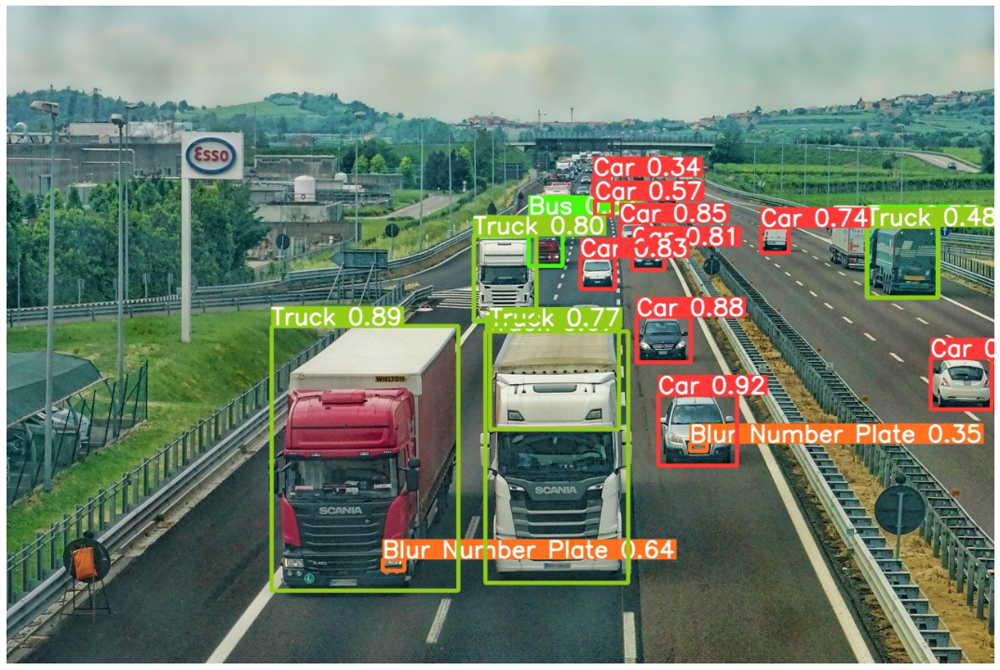

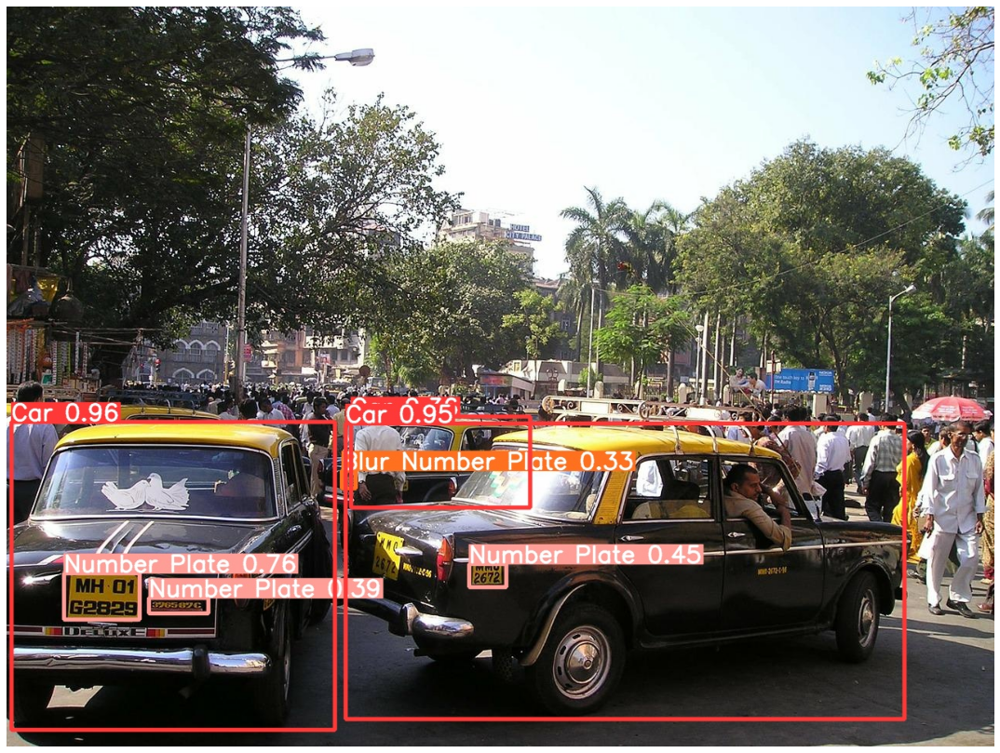

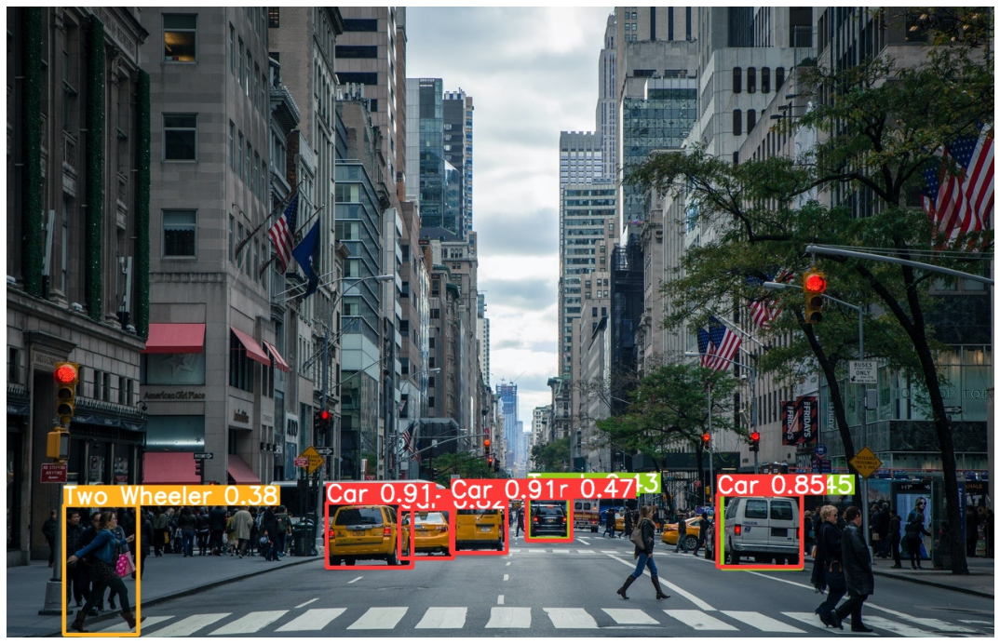

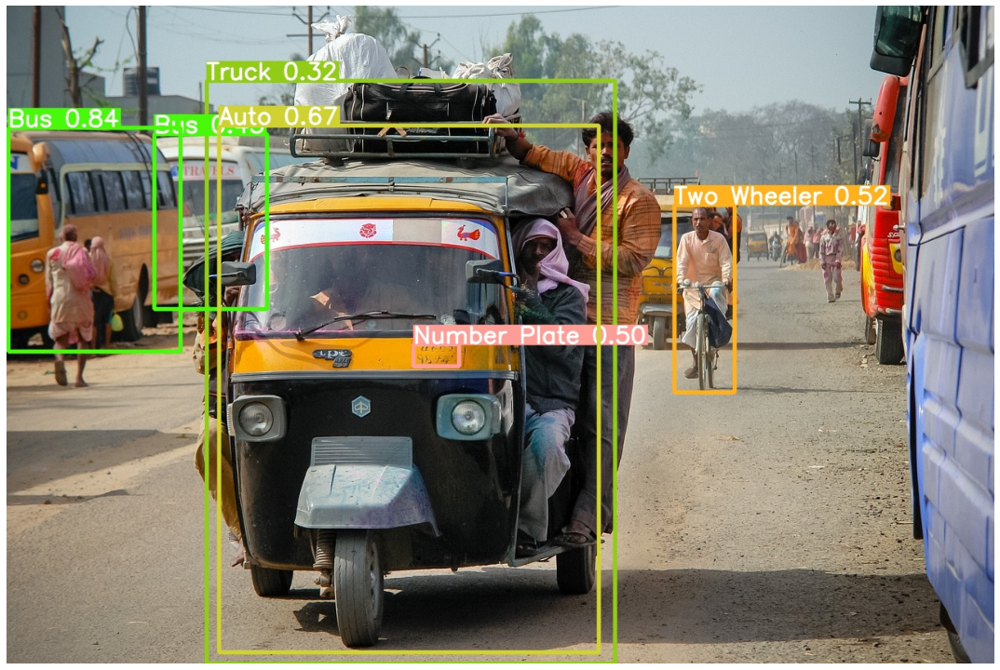

In [34]:
visualize(IMAGE_INFER_DIR)

In [35]:
inference(RES_DIR, 'inference_videos')

Current number of inference detection directories: 5
inference_6
detect: weights=['runs/train/results_3/weights/best.pt'], source=inference_videos, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=inference_6, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-117-g698a5d7 torch 1.11.0 CUDA:0 (NVIDIA GeForce GTX 1060, 6078MiB)

Fusing layers... 
Model summary: 290 layers, 20877180 parameters, 0 gradients
video 1/4 (1/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.017s)
video 1/4 (2/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/cod

video 1/4 (31/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 4 Cars, 1 Number Plate, 1 Blur Number Plate, 2 Two Wheelers, 1 Auto, 2 Buss, 1 Truck, Done. (0.016s)
video 1/4 (32/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 5 Cars, 1 Number Plate, 2 Blur Number Plates, 1 Two Wheeler, 1 Auto, 2 Buss, 2 Trucks, Done. (0.016s)
video 1/4 (33/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 5 Cars, 2 Number Plates, 1 Blur Number Plate, 1 Two Wheeler, 1 Auto, 2 Buss, 2 Trucks, Done. (0.016s)
video 1/4 (34/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 5 Cars, 2 Number Plates

video 1/4 (64/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 2 Cars, 2 Number Plates, 2 Blur Number Plates, 3 Buss, 2 Trucks, Done. (0.016s)
video 1/4 (65/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 3 Cars, 2 Number Plates, 1 Blur Number Plate, 2 Buss, 2 Trucks, Done. (0.016s)
video 1/4 (66/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 3 Cars, 2 Number Plates, 2 Blur Number Plates, 2 Buss, 2 Trucks, Done. (0.016s)
video 1/4 (67/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 5 Cars, 2 Number Plates, 2 Blur Number Plates, 2 Buss, 2 Trucks, Done. (0.016s)
video 1/4

video 1/4 (97/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 1 Car, 1 Number Plate, 1 Auto, 2 Buss, 1 Truck, Done. (0.016s)
video 1/4 (98/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 1 Car, 1 Number Plate, 1 Auto, 2 Buss, 1 Truck, Done. (0.016s)
video 1/4 (99/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 1 Car, 1 Number Plate, 1 Auto, 2 Buss, 1 Truck, Done. (0.017s)
video 1/4 (100/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 1 Car, 1 Number Plate, 2 Two Wheelers, 1 Auto, 2 Buss, 1 Truck, Done. (0.016s)
video 1/4 (101/513) /home/sovit/my_data/Data_Science/Big_Vi

video 1/4 (135/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 1 Two Wheeler, 2 Buss, 1 Truck, Done. (0.016s)
video 1/4 (136/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 1 Auto, 2 Buss, Done. (0.016s)
video 1/4 (137/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 1 Car, 1 Auto, 2 Buss, 1 Truck, Done. (0.016s)
video 1/4 (138/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 1 Auto, 2 Buss, 1 Truck, Done. (0.016s)
video 1/4 (139/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4

video 1/4 (175/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 3 Cars, 1 Two Wheeler, 2 Buss, 2 Trucks, Done. (0.016s)
video 1/4 (176/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 3 Cars, 1 Bus, 2 Trucks, Done. (0.016s)
video 1/4 (177/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 3 Cars, 1 Two Wheeler, 2 Buss, 2 Trucks, Done. (0.016s)
video 1/4 (178/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 4 Cars, 1 Two Wheeler, 2 Buss, 1 Truck, Done. (0.016s)
video 1/4 (179/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov

video 1/4 (214/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 5 Cars, 1 Number Plate, 1 Blur Number Plate, 1 Two Wheeler, 1 Auto, 1 Truck, Done. (0.016s)
video 1/4 (215/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 5 Cars, 1 Number Plate, 1 Blur Number Plate, 1 Auto, 1 Bus, 1 Truck, Done. (0.016s)
video 1/4 (216/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 5 Cars, 1 Blur Number Plate, 1 Bus, 1 Truck, Done. (0.016s)
video 1/4 (217/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 5 Cars, 1 Number Plate, 1 Bus, 2 Trucks, Done. (0.016s)
video 1/4 (218/513) /home/sovit/

video 1/4 (251/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 6 Cars, 1 Blur Number Plate, 1 Auto, 2 Buss, 1 Truck, Done. (0.016s)
video 1/4 (252/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 6 Cars, 1 Blur Number Plate, 1 Auto, 2 Buss, 3 Trucks, Done. (0.016s)
video 1/4 (253/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 6 Cars, 1 Blur Number Plate, 1 Two Wheeler, 1 Bus, 2 Trucks, Done. (0.016s)
video 1/4 (254/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 6 Cars, 1 Number Plate, 2 Blur Number Plates, 1 Auto, 1 Bus, 2 Trucks, Done. (0.016s)
video 1/4 (255/513) /ho

video 1/4 (292/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.016s)
video 1/4 (293/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.016s)
video 1/4 (294/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.016s)
video 1/4 (295/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.016s)
video 1/4 (296/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.016s)
video 1/4 (297/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_

video 1/4 (337/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.016s)
video 1/4 (338/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.016s)
video 1/4 (339/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.016s)
video 1/4 (340/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.016s)
video 1/4 (341/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.016s)
video 1/4 (342/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_

video 1/4 (382/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.017s)
video 1/4 (383/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.016s)
video 1/4 (384/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.016s)
video 1/4 (385/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.016s)
video 1/4 (386/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.016s)
video 1/4 (387/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_

video 1/4 (427/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.016s)
video 1/4 (428/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.016s)
video 1/4 (429/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.016s)
video 1/4 (430/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.016s)
video 1/4 (431/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.016s)
video 1/4 (432/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_

video 1/4 (469/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 3 Cars, Done. (0.016s)
video 1/4 (470/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 3 Cars, Done. (0.016s)
video 1/4 (471/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 3 Cars, Done. (0.016s)
video 1/4 (472/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 4 Cars, Done. (0.016s)
video 1/4 (473/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 4 Cars, 1 Two Wheeler, Done. (0.016s)
video 1/4 (474/513) /home

video 1/4 (509/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 6 Cars, 1 Two Wheeler, Done. (0.016s)
video 1/4 (510/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 6 Cars, 1 Two Wheeler, Done. (0.016s)
video 1/4 (511/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 6 Cars, 1 Two Wheeler, Done. (0.016s)
video 1/4 (512/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 6 Cars, 1 Two Wheeler, Done. (0.016s)
video 1/4 (513/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_1.mp4: 384x640 5 C

video 2/4 (31/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 4 Cars, 1 Number Plate, 1 Blur Number Plate, 6 Two Wheelers, 2 Autos, Done. (0.016s)
video 2/4 (32/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 4 Cars, 1 Number Plate, 9 Two Wheelers, 2 Autos, Done. (0.016s)
video 2/4 (33/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 6 Cars, 1 Number Plate, 1 Blur Number Plate, 8 Two Wheelers, 2 Autos, Done. (0.016s)
video 2/4 (34/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 4 Cars, 1 Number Plate, 1 Blur Number Plate, 9 Two Wheelers, 1 Auto, Done. (0.016s)
video 2/4 

video 2/4 (65/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 2 Cars, 5 Two Wheelers, 2 Autos, Done. (0.016s)
video 2/4 (66/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 2 Cars, 1 Blur Number Plate, 5 Two Wheelers, 1 Auto, Done. (0.016s)
video 2/4 (67/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 2 Cars, 5 Two Wheelers, 1 Auto, Done. (0.016s)
video 2/4 (68/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 3 Cars, 1 Blur Number Plate, 5 Two Wheelers, 1 Auto, Done. (0.016s)
video 2/4 (69/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_t

video 2/4 (100/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 5 Cars, 1 Number Plate, 5 Two Wheelers, Done. (0.016s)
video 2/4 (101/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 4 Cars, 1 Number Plate, 1 Blur Number Plate, 5 Two Wheelers, Done. (0.016s)
video 2/4 (102/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 4 Cars, 1 Number Plate, 1 Blur Number Plate, 5 Two Wheelers, Done. (0.016s)
video 2/4 (103/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 4 Cars, 1 Number Plate, 4 Two Wheelers, Done. (0.016s)
video 2/4 (104/610) /home/sovit/my_data/Data_Science/Big_Visio

video 2/4 (137/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 7 Cars, 1 Blur Number Plate, 6 Two Wheelers, Done. (0.016s)
video 2/4 (138/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 6 Cars, 1 Blur Number Plate, 8 Two Wheelers, Done. (0.016s)
video 2/4 (139/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 4 Cars, 1 Number Plate, 6 Two Wheelers, Done. (0.016s)
video 2/4 (140/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 3 Cars, 1 Number Plate, 6 Two Wheelers, Done. (0.016s)
video 2/4 (141/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detecti

video 2/4 (174/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 3 Cars, 6 Two Wheelers, Done. (0.016s)
video 2/4 (175/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 2 Cars, 5 Two Wheelers, Done. (0.016s)
video 2/4 (176/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 2 Cars, 5 Two Wheelers, Done. (0.016s)
video 2/4 (177/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 2 Cars, 7 Two Wheelers, Done. (0.016s)
video 2/4 (178/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640

video 2/4 (210/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 3 Cars, 1 Number Plate, 1 Blur Number Plate, 5 Two Wheelers, Done. (0.016s)
video 2/4 (211/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 3 Cars, 1 Blur Number Plate, 5 Two Wheelers, Done. (0.016s)
video 2/4 (212/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 4 Cars, 5 Two Wheelers, Done. (0.016s)
video 2/4 (213/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 3 Cars, 6 Two Wheelers, Done. (0.016s)
video 2/4 (214/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_usin

video 2/4 (246/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 4 Cars, 1 Number Plate, 8 Two Wheelers, 1 Auto, 2 Trucks, Done. (0.016s)
video 2/4 (247/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 4 Cars, 1 Number Plate, 6 Two Wheelers, 2 Trucks, Done. (0.016s)
video 2/4 (248/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 3 Cars, 1 Number Plate, 5 Two Wheelers, 2 Trucks, Done. (0.016s)
video 2/4 (249/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 3 Cars, 1 Number Plate, 6 Two Wheelers, 2 Trucks, Done. (0.016s)
video 2/4 (250/610) /home/sovit/my_data/Data_Science/Big

video 2/4 (283/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 5 Cars, 5 Two Wheelers, Done. (0.016s)
video 2/4 (284/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 6 Cars, 4 Two Wheelers, Done. (0.016s)
video 2/4 (285/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 7 Cars, 1 Blur Number Plate, 4 Two Wheelers, Done. (0.016s)
video 2/4 (286/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 7 Cars, 4 Two Wheelers, Done. (0.016s)
video 2/4 (287/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos

video 2/4 (322/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 6 Cars, 3 Two Wheelers, Done. (0.016s)
video 2/4 (323/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 5 Cars, 1 Blur Number Plate, 4 Two Wheelers, Done. (0.016s)
video 2/4 (324/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 5 Cars, 5 Two Wheelers, Done. (0.016s)
video 2/4 (325/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 5 Cars, 4 Two Wheelers, Done. (0.016s)
video 2/4 (326/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos

video 2/4 (361/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 4 Cars, 1 Number Plate, 2 Blur Number Plates, 4 Two Wheelers, Done. (0.016s)
video 2/4 (362/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 5 Cars, 1 Number Plate, 2 Blur Number Plates, 3 Two Wheelers, Done. (0.016s)
video 2/4 (363/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 5 Cars, 1 Number Plate, 1 Blur Number Plate, 3 Two Wheelers, Done. (0.016s)
video 2/4 (364/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 5 Cars, 1 Number Plate, 2 Blur Number Plates, 5 Two Wheelers, Done. (0.016s)
video 2/4 (365/61

video 2/4 (396/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 4 Cars, 1 Number Plate, 1 Blur Number Plate, 5 Two Wheelers, Done. (0.016s)
video 2/4 (397/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 4 Cars, 1 Number Plate, 5 Two Wheelers, Done. (0.016s)
video 2/4 (398/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 4 Cars, 1 Number Plate, 6 Two Wheelers, Done. (0.016s)
video 2/4 (399/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 4 Cars, 1 Number Plate, 5 Two Wheelers, Done. (0.016s)
video 2/4 (400/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_obj

video 2/4 (436/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 5 Cars, 4 Two Wheelers, Done. (0.016s)
video 2/4 (437/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 5 Cars, 6 Two Wheelers, Done. (0.016s)
video 2/4 (438/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 6 Cars, 4 Two Wheelers, Done. (0.016s)
video 2/4 (439/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 6 Cars, 2 Blur Number Plates, 5 Two Wheelers, Done. (0.016s)
video 2/4 (440/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_video

video 2/4 (473/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 6 Cars, 1 Number Plate, 1 Blur Number Plate, 2 Two Wheelers, Done. (0.016s)
video 2/4 (474/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 6 Cars, 1 Number Plate, 1 Blur Number Plate, 2 Two Wheelers, Done. (0.016s)
video 2/4 (475/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 6 Cars, 1 Number Plate, 2 Two Wheelers, Done. (0.016s)
video 2/4 (476/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 6 Cars, 1 Number Plate, 2 Two Wheelers, Done. (0.016s)
video 2/4 (477/610) /home/sovit/my_data/Data_Science/Big_Visio

video 2/4 (509/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 7 Cars, 1 Blur Number Plate, Done. (0.016s)
video 2/4 (510/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 7 Cars, 1 Two Wheeler, Done. (0.016s)
video 2/4 (511/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 7 Cars, 1 Two Wheeler, Done. (0.016s)
video 2/4 (512/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 6 Cars, 1 Two Wheeler, Done. (0.016s)
video 2/4 (513/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x6

video 2/4 (546/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 5 Cars, 1 Blur Number Plate, 1 Two Wheeler, Done. (0.016s)
video 2/4 (547/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 5 Cars, 1 Blur Number Plate, 1 Two Wheeler, Done. (0.016s)
video 2/4 (548/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 5 Cars, 1 Blur Number Plate, 2 Two Wheelers, Done. (0.016s)
video 2/4 (549/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 5 Cars, 1 Number Plate, 1 Blur Number Plate, 1 Two Wheeler, Done. (0.016s)
video 2/4 (550/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blog

video 2/4 (582/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 6 Cars, 1 Two Wheeler, Done. (0.016s)
video 2/4 (583/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 6 Cars, 1 Two Wheeler, Done. (0.016s)
video 2/4 (584/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 8 Cars, 1 Two Wheeler, Done. (0.016s)
video 2/4 (585/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 7 Cars, 1 Two Wheeler, Done. (0.016s)
video 2/4 (586/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_2.mp4: 384x640 7 C

video 3/4 (9/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 9 Cars, 2 Blur Number Plates, 7 Two Wheelers, 2 Autos, 2 Buss, 4 Trucks, Done. (0.016s)
video 3/4 (10/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 9 Cars, 2 Blur Number Plates, 8 Two Wheelers, 2 Autos, 2 Buss, 4 Trucks, Done. (0.016s)
video 3/4 (11/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 10 Cars, 1 Blur Number Plate, 5 Two Wheelers, 1 Auto, 2 Buss, 4 Trucks, Done. (0.016s)
video 3/4 (12/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 9 Cars, 1 Blur Number Plate, 5 Two Wheelers, 1 Auto, 3 Buss, 4 Tru

video 3/4 (43/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 8 Cars, 2 Blur Number Plates, 6 Two Wheelers, 1 Auto, 1 Bus, 3 Trucks, Done. (0.016s)
video 3/4 (44/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 8 Cars, 2 Blur Number Plates, 6 Two Wheelers, 1 Auto, 2 Buss, 3 Trucks, Done. (0.016s)
video 3/4 (45/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 8 Cars, 2 Blur Number Plates, 6 Two Wheelers, 1 Auto, 3 Buss, 4 Trucks, Done. (0.016s)
video 3/4 (46/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 8 Cars, 2 Blur Number Plates, 6 Two Wheelers, 1 Auto, 3 Buss, 4 Truc

video 3/4 (77/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 8 Cars, 7 Two Wheelers, 3 Buss, 3 Trucks, Done. (0.016s)
video 3/4 (78/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 6 Cars, 1 Blur Number Plate, 8 Two Wheelers, 3 Buss, 3 Trucks, Done. (0.016s)
video 3/4 (79/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 7 Cars, 1 Blur Number Plate, 8 Two Wheelers, 3 Buss, 3 Trucks, Done. (0.016s)
video 3/4 (80/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 7 Cars, 7 Two Wheelers, 2 Buss, 3 Trucks, Done. (0.016s)
video 3/4 (81/246) /home/sovit/my_data/Data_Science/Big_Vi

video 3/4 (112/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 9 Cars, 1 Number Plate, 1 Blur Number Plate, 6 Two Wheelers, 1 Auto, 2 Buss, 5 Trucks, Done. (0.016s)
video 3/4 (113/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 8 Cars, 1 Number Plate, 1 Blur Number Plate, 6 Two Wheelers, 1 Auto, 2 Buss, 5 Trucks, Done. (0.016s)
video 3/4 (114/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 9 Cars, 1 Number Plate, 5 Two Wheelers, 1 Auto, 1 Bus, 5 Trucks, Done. (0.016s)
video 3/4 (115/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 9 Cars, 1 Number Plate, 6 Two Wheelers, 

video 3/4 (144/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 9 Cars, 1 Number Plate, 8 Two Wheelers, 2 Autos, 1 Bus, 2 Trucks, Done. (0.016s)
video 3/4 (145/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 10 Cars, 1 Number Plate, 7 Two Wheelers, 3 Autos, 1 Bus, 3 Trucks, Done. (0.016s)
video 3/4 (146/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 10 Cars, 1 Number Plate, 7 Two Wheelers, 3 Autos, 1 Bus, 3 Trucks, Done. (0.016s)
video 3/4 (147/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 10 Cars, 1 Number Plate, 1 Blur Number Plate, 7 Two Wheelers, 3 Autos, 1 Bus, 2

video 3/4 (176/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 12 Cars, 1 Number Plate, 7 Two Wheelers, 2 Autos, 4 Trucks, Done. (0.016s)
video 3/4 (177/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 11 Cars, 1 Number Plate, 2 Blur Number Plates, 7 Two Wheelers, 2 Autos, 1 Bus, 4 Trucks, Done. (0.016s)
video 3/4 (178/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 9 Cars, 1 Number Plate, 1 Blur Number Plate, 7 Two Wheelers, 2 Autos, 1 Bus, 4 Trucks, Done. (0.016s)
video 3/4 (179/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 9 Cars, 1 Number Plate, 1 Blur Number Plate

video 3/4 (207/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 9 Cars, 1 Blur Number Plate, 7 Two Wheelers, 1 Auto, 1 Bus, 3 Trucks, Done. (0.016s)
video 3/4 (208/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 8 Cars, 1 Blur Number Plate, 6 Two Wheelers, 1 Auto, 1 Bus, 3 Trucks, Done. (0.016s)
video 3/4 (209/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 8 Cars, 1 Blur Number Plate, 6 Two Wheelers, 1 Auto, 1 Bus, 3 Trucks, Done. (0.016s)
video 3/4 (210/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 9 Cars, 1 Blur Number Plate, 7 Two Wheelers, 2 Autos, 1 Bus, 3 Trucks

video 3/4 (239/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 9 Cars, 1 Number Plate, 2 Blur Number Plates, 7 Two Wheelers, 1 Auto, 2 Buss, 4 Trucks, Done. (0.016s)
video 3/4 (240/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 8 Cars, 1 Number Plate, 2 Blur Number Plates, 6 Two Wheelers, 1 Auto, 3 Buss, 4 Trucks, Done. (0.016s)
video 3/4 (241/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 9 Cars, 1 Number Plate, 1 Blur Number Plate, 6 Two Wheelers, 1 Auto, 3 Buss, 4 Trucks, Done. (0.016s)
video 3/4 (242/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_3.mp4: 384x640 9 Cars, 1 Number

video 4/4 (28/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 3 Number Plates, 3 Trucks, Done. (0.016s)
video 4/4 (29/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 3 Number Plates, 3 Trucks, Done. (0.016s)
video 4/4 (30/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 3 Number Plates, 3 Trucks, Done. (0.016s)
video 4/4 (31/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 3 Number Plates, 3 Trucks, Done. (0.016s)
video 4/4 (32/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/c

video 4/4 (64/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 2 Number Plates, 1 Blur Number Plate, 1 Bus, 3 Trucks, Done. (0.016s)
video 4/4 (65/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 2 Number Plates, 1 Blur Number Plate, 2 Buss, 3 Trucks, Done. (0.016s)
video 4/4 (66/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 3 Number Plates, 1 Blur Number Plate, 2 Buss, 3 Trucks, Done. (0.016s)
video 4/4 (67/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 3 Number Plates, 1 Blur Number Plate, 1 Bus, 2 Trucks, Done. (0.016s)
video 

video 4/4 (98/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 3 Number Plates, 1 Blur Number Plate, 1 Bus, 3 Trucks, Done. (0.016s)
video 4/4 (99/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 4 Number Plates, 2 Blur Number Plates, 1 Bus, 3 Trucks, Done. (0.016s)
video 4/4 (100/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 4 Number Plates, 1 Bus, 4 Trucks, Done. (0.016s)
video 4/4 (101/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 4 Number Plates, 2 Buss, 5 Trucks, Done. (0.016s)
video 4/4 (102/1501) /home/sovit/my_data/Data_

video 4/4 (134/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 21 Cars, 2 Number Plates, 2 Trucks, Done. (0.016s)
video 4/4 (135/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 22 Cars, 2 Number Plates, 3 Trucks, Done. (0.016s)
video 4/4 (136/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 21 Cars, 2 Number Plates, 3 Trucks, Done. (0.016s)
video 4/4 (137/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 20 Cars, 2 Number Plates, 3 Trucks, Done. (0.016s)
video 4/4 (138/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yol

video 4/4 (170/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 20 Cars, 2 Number Plates, 2 Trucks, Done. (0.016s)
video 4/4 (171/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 20 Cars, 2 Number Plates, 2 Trucks, Done. (0.016s)
video 4/4 (172/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 21 Cars, 2 Number Plates, 2 Trucks, Done. (0.016s)
video 4/4 (173/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 21 Cars, 2 Number Plates, 1 Bus, 2 Trucks, Done. (0.016s)
video 4/4 (174/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_us

video 4/4 (207/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 3 Number Plates, 2 Trucks, Done. (0.016s)
video 4/4 (208/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 3 Number Plates, 2 Trucks, Done. (0.016s)
video 4/4 (209/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 2 Number Plates, 3 Trucks, Done. (0.016s)
video 4/4 (210/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 2 Number Plates, 1 Blur Number Plate, 3 Trucks, Done. (0.016s)
video 4/4 (211/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detecti

video 4/4 (245/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 2 Number Plates, 2 Trucks, Done. (0.017s)
video 4/4 (246/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 2 Number Plates, 2 Trucks, Done. (0.016s)
video 4/4 (247/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 2 Number Plates, 2 Trucks, Done. (0.016s)
video 4/4 (248/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 2 Number Plates, 2 Trucks, Done. (0.016s)
video 4/4 (249/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yol

video 4/4 (282/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 1 Number Plate, 3 Trucks, Done. (0.016s)
video 4/4 (283/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 1 Number Plate, 3 Trucks, Done. (0.016s)
video 4/4 (284/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 1 Number Plate, 3 Trucks, Done. (0.016s)
video 4/4 (285/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 1 Number Plate, 3 Trucks, Done. (0.016s)
video 4/4 (286/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/

video 4/4 (320/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 3 Number Plates, 3 Trucks, Done. (0.016s)
video 4/4 (321/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 3 Number Plates, 3 Trucks, Done. (0.016s)
video 4/4 (322/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 3 Number Plates, 3 Trucks, Done. (0.016s)
video 4/4 (323/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 3 Number Plates, 3 Trucks, Done. (0.016s)
video 4/4 (324/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yol

video 4/4 (356/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 3 Number Plates, 1 Blur Number Plate, 3 Trucks, Done. (0.016s)
video 4/4 (357/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 2 Number Plates, 1 Blur Number Plate, 3 Trucks, Done. (0.016s)
video 4/4 (358/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 2 Number Plates, 1 Blur Number Plate, 3 Trucks, Done. (0.016s)
video 4/4 (359/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 3 Number Plates, 1 Blur Number Plate, 3 Trucks, Done. (0.016s)
video 4/4 (360/1501) /home/sovit

video 4/4 (391/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 3 Number Plates, 1 Blur Number Plate, 3 Trucks, Done. (0.016s)
video 4/4 (392/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 15 Cars, 3 Number Plates, 1 Blur Number Plate, 3 Trucks, Done. (0.016s)
video 4/4 (393/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 3 Number Plates, 1 Blur Number Plate, 3 Trucks, Done. (0.016s)
video 4/4 (394/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 3 Number Plates, 1 Blur Number Plate, 3 Trucks, Done. (0.016s)
video 4/4 (395/1501) /home/sovit

video 4/4 (426/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 20 Cars, 2 Number Plates, 2 Blur Number Plates, 3 Trucks, Done. (0.016s)
video 4/4 (427/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 2 Number Plates, 1 Blur Number Plate, 1 Auto, 3 Trucks, Done. (0.016s)
video 4/4 (428/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 20 Cars, 2 Number Plates, 1 Blur Number Plate, 1 Auto, 3 Trucks, Done. (0.016s)
video 4/4 (429/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 2 Number Plates, 1 Blur Number Plate, 1 Auto, 2 Trucks, Done. (0.016s)
video 4

video 4/4 (460/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 22 Cars, 2 Number Plates, 2 Blur Number Plates, 2 Trucks, Done. (0.016s)
video 4/4 (461/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 21 Cars, 2 Number Plates, 2 Blur Number Plates, 2 Trucks, Done. (0.016s)
video 4/4 (462/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 20 Cars, 2 Number Plates, 3 Blur Number Plates, 2 Trucks, Done. (0.016s)
video 4/4 (463/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 20 Cars, 2 Number Plates, 2 Blur Number Plates, 2 Trucks, Done. (0.016s)
video 4/4 (464/1501) /home/s

video 4/4 (494/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 2 Number Plates, 1 Blur Number Plate, 2 Trucks, Done. (0.016s)
video 4/4 (495/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 3 Number Plates, 2 Blur Number Plates, 2 Trucks, Done. (0.016s)
video 4/4 (496/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 3 Number Plates, 2 Trucks, Done. (0.016s)
video 4/4 (497/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 3 Number Plates, 1 Blur Number Plate, 2 Trucks, Done. (0.016s)
video 4/4 (498/1501) /home/sovit/my_data/Data_Scienc

video 4/4 (528/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 2 Number Plates, 2 Blur Number Plates, 2 Trucks, Done. (0.016s)
video 4/4 (529/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 2 Number Plates, 3 Blur Number Plates, 3 Trucks, Done. (0.016s)
video 4/4 (530/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 3 Number Plates, 1 Blur Number Plate, 1 Auto, 3 Trucks, Done. (0.016s)
video 4/4 (531/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 1 Number Plate, 2 Blur Number Plates, 1 Auto, 3 Trucks, Done. (0.016s)
video 4/4 (532

video 4/4 (564/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 15 Cars, 2 Number Plates, 1 Blur Number Plate, 3 Trucks, Done. (0.016s)
video 4/4 (565/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 15 Cars, 1 Number Plate, 1 Blur Number Plate, 2 Trucks, Done. (0.016s)
video 4/4 (566/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 15 Cars, 1 Number Plate, 1 Blur Number Plate, 3 Trucks, Done. (0.016s)
video 4/4 (567/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 15 Cars, 2 Number Plates, 1 Blur Number Plate, 1 Bus, 3 Trucks, Done. (0.016s)
video 4/4 (568/1501) /home/

video 4/4 (601/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 3 Number Plates, 2 Blur Number Plates, 5 Trucks, Done. (0.016s)
video 4/4 (602/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 15 Cars, 4 Number Plates, 1 Blur Number Plate, 5 Trucks, Done. (0.016s)
video 4/4 (603/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 3 Number Plates, 2 Blur Number Plates, 5 Trucks, Done. (0.016s)
video 4/4 (604/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 3 Number Plates, 2 Blur Number Plates, 5 Trucks, Done. (0.016s)
video 4/4 (605/1501) /home/so

video 4/4 (637/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 15 Cars, 2 Number Plates, 1 Blur Number Plate, 5 Trucks, Done. (0.016s)
video 4/4 (638/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 2 Number Plates, 1 Blur Number Plate, 5 Trucks, Done. (0.016s)
video 4/4 (639/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 3 Number Plates, 1 Blur Number Plate, 5 Trucks, Done. (0.016s)
video 4/4 (640/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 15 Cars, 2 Number Plates, 4 Trucks, Done. (0.016s)
video 4/4 (641/1501) /home/sovit/my_data/Data_Science

video 4/4 (674/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 15 Cars, 3 Number Plates, 1 Truck, Done. (0.016s)
video 4/4 (675/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 15 Cars, 4 Number Plates, 3 Trucks, Done. (0.016s)
video 4/4 (676/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 4 Number Plates, 4 Trucks, Done. (0.016s)
video 4/4 (677/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 15 Cars, 4 Number Plates, 3 Trucks, Done. (0.016s)
video 4/4 (678/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolo

video 4/4 (712/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 15 Cars, 3 Number Plates, Done. (0.016s)
video 4/4 (713/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 15 Cars, 3 Number Plates, Done. (0.016s)
video 4/4 (714/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 3 Number Plates, Done. (0.016s)
video 4/4 (715/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 3 Number Plates, Done. (0.016s)
video 4/4 (716/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4

video 4/4 (749/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 2 Number Plates, 1 Blur Number Plate, 1 Truck, Done. (0.016s)
video 4/4 (750/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 15 Cars, 3 Number Plates, 2 Trucks, Done. (0.016s)
video 4/4 (751/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 15 Cars, 3 Number Plates, 2 Trucks, Done. (0.016s)
video 4/4 (752/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 15 Cars, 3 Number Plates, 2 Trucks, Done. (0.016s)
video 4/4 (753/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detectio

video 4/4 (787/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 1 Number Plate, 2 Trucks, Done. (0.016s)
video 4/4 (788/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 1 Number Plate, 2 Trucks, Done. (0.016s)
video 4/4 (789/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 1 Number Plate, 1 Truck, Done. (0.016s)
video 4/4 (790/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 1 Number Plate, 1 Truck, Done. (0.016s)
video 4/4 (791/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/co

video 4/4 (825/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 1 Number Plate, 2 Trucks, Done. (0.016s)
video 4/4 (826/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 1 Number Plate, 2 Trucks, Done. (0.016s)
video 4/4 (827/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 20 Cars, 1 Number Plate, 2 Trucks, Done. (0.016s)
video 4/4 (828/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 21 Cars, 1 Number Plate, 2 Trucks, Done. (0.016s)
video 4/4 (829/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/

video 4/4 (864/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 23 Cars, 1 Truck, Done. (0.016s)
video 4/4 (865/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 21 Cars, 1 Truck, Done. (0.016s)
video 4/4 (866/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 22 Cars, 1 Truck, Done. (0.016s)
video 4/4 (867/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 22 Cars, 1 Truck, Done. (0.016s)
video 4/4 (868/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 22 Cars, 1 Truck, 

video 4/4 (905/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 1 Blur Number Plate, 1 Truck, Done. (0.016s)
video 4/4 (906/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 1 Blur Number Plate, 1 Truck, Done. (0.016s)
video 4/4 (907/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 1 Blur Number Plate, 1 Truck, Done. (0.016s)
video 4/4 (908/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 1 Blur Number Plate, 1 Truck, Done. (0.016s)
video 4/4 (909/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_traini

video 4/4 (941/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 1 Number Plate, 1 Blur Number Plate, 1 Truck, Done. (0.016s)
video 4/4 (942/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 1 Number Plate, 1 Blur Number Plate, 1 Truck, Done. (0.016s)
video 4/4 (943/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 1 Number Plate, 1 Blur Number Plate, 2 Trucks, Done. (0.016s)
video 4/4 (944/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 1 Number Plate, 1 Blur Number Plate, 2 Trucks, Done. (0.016s)
video 4/4 (945/1501) /home/sovit/my_da

video 4/4 (977/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 20 Cars, 1 Number Plate, 1 Blur Number Plate, 1 Truck, Done. (0.016s)
video 4/4 (978/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 1 Number Plate, 1 Blur Number Plate, 1 Truck, Done. (0.016s)
video 4/4 (979/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 1 Number Plate, 1 Blur Number Plate, 1 Truck, Done. (0.016s)
video 4/4 (980/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 1 Number Plate, 1 Blur Number Plate, 1 Truck, Done. (0.016s)
video 4/4 (981/1501) /home/sovit/my_data

video 4/4 (1014/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 20 Cars, 1 Number Plate, 1 Truck, Done. (0.016s)
video 4/4 (1015/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 21 Cars, 1 Number Plate, 1 Truck, Done. (0.016s)
video 4/4 (1016/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 20 Cars, 1 Number Plate, 1 Truck, Done. (0.016s)
video 4/4 (1017/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 20 Cars, 1 Number Plate, 1 Truck, Done. (0.016s)
video 4/4 (1018/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5

video 4/4 (1053/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 1 Number Plate, Done. (0.017s)
video 4/4 (1054/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 1 Number Plate, Done. (0.017s)
video 4/4 (1055/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 1 Number Plate, Done. (0.017s)
video 4/4 (1056/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 20 Cars, 1 Number Plate, Done. (0.016s)
video 4/4 (1057/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_

video 4/4 (1091/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 2 Number Plates, 1 Blur Number Plate, Done. (0.016s)
video 4/4 (1092/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 2 Number Plates, Done. (0.016s)
video 4/4 (1093/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 2 Number Plates, Done. (0.016s)
video 4/4 (1094/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 2 Number Plates, Done. (0.016s)
video 4/4 (1095/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov

video 4/4 (1130/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 2 Number Plates, 1 Truck, Done. (0.016s)
video 4/4 (1131/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 20 Cars, 2 Number Plates, 1 Blur Number Plate, Done. (0.016s)
video 4/4 (1132/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 21 Cars, 2 Number Plates, Done. (0.016s)
video 4/4 (1133/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 21 Cars, 2 Number Plates, Done. (0.016s)
video 4/4 (1134/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/c

video 4/4 (1168/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 23 Cars, 2 Number Plates, Done. (0.016s)
video 4/4 (1169/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 23 Cars, 2 Number Plates, 1 Truck, Done. (0.016s)
video 4/4 (1170/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 23 Cars, 2 Number Plates, 1 Blur Number Plate, 1 Truck, Done. (0.016s)
video 4/4 (1171/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 22 Cars, 2 Number Plates, 1 Blur Number Plate, 1 Truck, Done. (0.016s)
video 4/4 (1172/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_o

video 4/4 (1206/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 20 Cars, 1 Number Plate, 1 Auto, 1 Truck, Done. (0.016s)
video 4/4 (1207/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 1 Number Plate, 1 Auto, 1 Truck, Done. (0.016s)
video 4/4 (1208/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 20 Cars, 1 Number Plate, 1 Auto, 1 Truck, Done. (0.016s)
video 4/4 (1209/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 1 Number Plate, 1 Auto, 2 Trucks, Done. (0.016s)
video 4/4 (1210/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_objec

video 4/4 (1245/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 2 Trucks, Done. (0.017s)
video 4/4 (1246/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 2 Trucks, Done. (0.017s)
video 4/4 (1247/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 2 Autos, 2 Trucks, Done. (0.017s)
video 4/4 (1248/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 1 Auto, 3 Trucks, Done. (0.016s)
video 4/4 (1249/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 

video 4/4 (1282/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 1 Number Plate, 1 Blur Number Plate, 2 Trucks, Done. (0.016s)
video 4/4 (1283/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 1 Number Plate, 2 Trucks, Done. (0.016s)
video 4/4 (1284/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 1 Number Plate, 1 Blur Number Plate, 2 Trucks, Done. (0.016s)
video 4/4 (1285/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 1 Number Plate, 1 Blur Number Plate, 2 Trucks, Done. (0.016s)
video 4/4 (1286/1501) /home/sovit/my_data/Data_Scienc

video 4/4 (1317/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 1 Number Plate, 3 Trucks, Done. (0.016s)
video 4/4 (1318/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 1 Number Plate, 1 Two Wheeler, 1 Auto, 3 Trucks, Done. (0.016s)
video 4/4 (1319/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 1 Number Plate, 3 Trucks, Done. (0.016s)
video 4/4 (1320/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 1 Number Plate, 1 Blur Number Plate, 3 Trucks, Done. (0.016s)
video 4/4 (1321/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blo

video 4/4 (1353/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 20 Cars, 1 Number Plate, 1 Blur Number Plate, 1 Two Wheeler, 2 Trucks, Done. (0.016s)
video 4/4 (1354/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 20 Cars, 1 Number Plate, 1 Blur Number Plate, 1 Two Wheeler, 2 Trucks, Done. (0.016s)
video 4/4 (1355/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 21 Cars, 3 Number Plates, 1 Blur Number Plate, 1 Two Wheeler, 2 Trucks, Done. (0.016s)
video 4/4 (1356/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 22 Cars, 3 Number Plates, 1 Blur Number Plate, 1 Two Whee

video 4/4 (1387/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 20 Cars, 2 Number Plates, 1 Auto, 2 Trucks, Done. (0.016s)
video 4/4 (1388/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 20 Cars, 2 Number Plates, 2 Trucks, Done. (0.016s)
video 4/4 (1389/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 20 Cars, 2 Number Plates, 2 Trucks, Done. (0.016s)
video 4/4 (1390/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 2 Number Plates, 2 Trucks, Done. (0.016s)
video 4/4 (1391/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_train

video 4/4 (1423/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 2 Number Plates, 1 Blur Number Plate, 2 Trucks, Done. (0.016s)
video 4/4 (1424/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 20 Cars, 2 Number Plates, 1 Blur Number Plate, 2 Trucks, Done. (0.016s)
video 4/4 (1425/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 2 Number Plates, 2 Blur Number Plates, 2 Trucks, Done. (0.016s)
video 4/4 (1426/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 20 Cars, 2 Number Plates, 1 Blur Number Plate, 2 Trucks, Done. (0.016s)
video 4/4 (1427/1501) /home

video 4/4 (1459/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 21 Cars, 3 Number Plates, 1 Blur Number Plate, 2 Trucks, Done. (0.017s)
video 4/4 (1460/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 21 Cars, 3 Number Plates, 1 Blur Number Plate, 2 Trucks, Done. (0.016s)
video 4/4 (1461/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 21 Cars, 2 Number Plates, 2 Blur Number Plates, 2 Trucks, Done. (0.016s)
video 4/4 (1462/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 22 Cars, 3 Number Plates, 1 Blur Number Plate, 2 Trucks, Done. (0.016s)
video 4/4 (1463/1501) /home

video 4/4 (1494/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 20 Cars, 1 Number Plate, 1 Truck, Done. (0.016s)
video 4/4 (1495/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, 1 Number Plate, 1 Blur Number Plate, 1 Truck, Done. (0.017s)
video 4/4 (1496/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 20 Cars, 1 Number Plate, 1 Blur Number Plate, 2 Trucks, Done. (0.016s)
video 4/4 (1497/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/code/yolov5/inference_videos/video_4.mp4: 384x640 22 Cars, 1 Number Plate, 1 Blur Number Plate, 2 Trucks, Done. (0.016s)
video 4/4 (1498/1501) /home/sovit/my_data/Data_Science/

'inference_6'